In [1]:
import scanpy as sc
adata=sc.read_h5ad('/nfs/team298/ls34/new_disease_atlas/model_scanvi5_Wound_5846/adata_mappedonly_notatlas.h5ad.counts')
adata
adata.obs.provisional_celltypes.value_counts()

provisional_celltypes
KC3                   15240
F*_perikeloid          6259
KC1                    5332
KCinflamm_int          2513
lowq                   2453
                      ...  
LC_CCR7+                  4
KC_SC: LGR6+ACTA2+        4
Tc_IL13                   2
Pericyte*                 2
F4: DP_HHIP+              1
Name: count, Length: 69, dtype: int64

In [2]:
TIME =  {
    "PWH26D1": "Day1",
    "PWH26D7": "Day7",
    "PWH27D1": "Day1",
    "PWH27D7": "Day7",
    "PWH28D1": "Day1",
    "PWH28D7": "Day7",
    "PWH26D0": "Baseline",
    "PWH26D30": "Day30",
    "PWH27D0": "Baseline",
    "PWH27D30": "Day30",
    "PWH28D0": "Day30",
    "PWH28D30": "Day30"
}
adata.obs["Time"]=adata.obs["sample_id"].map(TIME)


In [3]:
adata[adata.obs.provisional_celltypes=="nmSchwann"].obs.Time.value_counts()

Time
Day30       105
Day7         10
Day1          6
Baseline      6
Name: count, dtype: int64

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


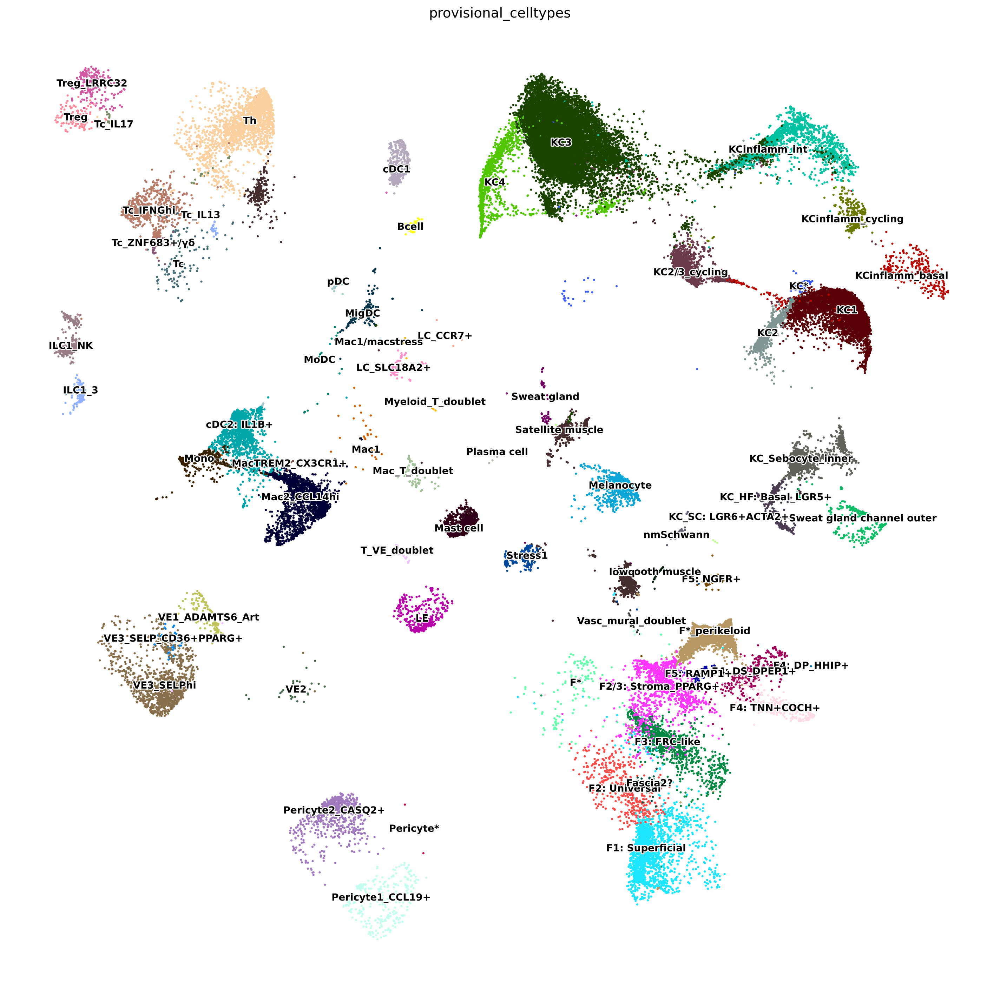

In [4]:
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata,  
       color = [  "provisional_celltypes",#"Mapping_status"
               ],
                
      s=20, vmax=5, vmin=-10,
     legend_loc="on data", 
           legend_fontoutline=2,
      legend_fontsize=10)
# sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
# sc.pl.umap(adata,  
#        color = [ "lvl4_annotation", 
#                ],|
                
#       s=2, vmax=5, vmin=-10,
#       legend_loc="on data", legend_fontoutline=2,
#       legend_fontsize=10)

In [9]:
adata_i = adata[adata.obs["provisional_celltypes"].str.startswith("M")]

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

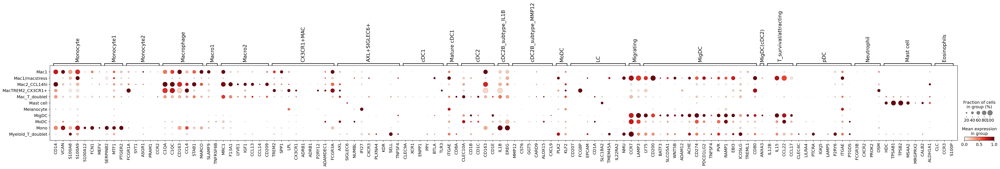

In [11]:
mac_markers={ 'Monocyte': ['CD14', 'VCAN', 'S100A8', 'S100A9', 
              'S100A12', "FCN1",'MEFV'], #"FCGR3A"
 'Monocyte1': ['SERPINB2', 'MTF1', 'PTGER2'],
 'Monocyte2': ['FCGR1A', 'SYT1', 'ASGR1', 'PRAM1', 'CCR2'],
# 'Mono_KC': ['KRT16', 'EGFR'],
 'Macrophage': ['C1QA', 'C1QC',  'CD163', 'CCL4', "STAB1",'MARCO', ],
      'Macro1': ['SLAMF9', 'TNFRSF6B',#"CXCL5", #"IL24"
                # "CCL24"
                ],

 'Macro2': ['MRC1','F13A1', "LYVE1","IGF1", "CCL13", 'CCL14', "CD209"],
 #'T': ['CD3E', 'CD96', 'TRBC1'],
 #'Macro_NEU4/LRRC32': ['CCL4L2', 'CCRL2', 'ACHE', 'NEU4', 'IL23A', 'CD40'],
# 'TREM2+ADAMDEC1+': ['TREM2', 'CXCL5', 'EPHB2', 'STAC', 'FAM20C'],
 'CX3CR1+MAC': ['TREM2', 'SPP1',  "LPL", 'CX3CR1', 'ADRB1', 
              # "KCNQ3"#"UNC5B", "GPR34", "SMAD7",  "CD72", "TGFBR1", 
             #  "CD9",
               "ADRB1",
                "P2RY12", 'ADAMDEC1', 'FCGR3A', 
               ],
             'AXL+SIGLEC6+': ['AXL', 'SIGLEC6', 'NUMBL', 'IFI27', 'CXCR3', 'PLXNA4', 'KDR', "SELL",
                             "TNFSF4"],

 'cDC1': ['CLEC9A', 'XCR1', "ENPP1", "PPY", "BTLA", "TLR3"],
             "Mature cDC1": ["ITGAE", "CD8A"],
 'cDC2': ['CLEC10A', 'CD1B', 'CD1C', "CD163", 'CD1E', # 'CD5', 
          #'SPIB', 'TNFSF4', 'TSPAN2'
         ],
 'cDC2B_subtype_IL1B': ['IL1B',"EREG", #'CROCC',
                   ],
             'cDC2B_subtype_MMP12': ['MMP12', "CST6", "GGT5", "CARD9",  "ALOX15", "CXCL9",#'CROCC',
                   ],
              'MoDC': ["PLK2", "KLF2",
                  #'THBS1',  'C1QTNF1', "INHBA", "TNFRSF4"
              ],

 'LC': ['CD207','FCGBP', "EPCAM", 'CD1A', "SLC18A2", "TMEM45A", "IL22RA2","NMU" #"CLEC4A"
       ],
 'Migrating': ['CCR7', 'LAMP3',  ], 
 'MigDC': ['LY75', "CD200",  "BATF3",'SLCO5A1', 'WNT5B', 'ADAM12', "ACHE",
           "CD274", "PDCD1LG2",  "TNFSF4", "PVR", "RAMP1" , "EBI3","ICOSLG",
          "TREML1", "CD80", ],  #'ST8SIA1', 'CCL19', "CCL17", "CCL22",
         
     #"TFPI", "SERINC2", #"IL10",
          #'LILRA1', 'LILRA2'
             "MigDC(cDC2)": ["ANXA3"],
             "T_survival/attracting": ["IL12B", "IL15",  "CCL22", "CCL17", ],
 'pDC': ['CLEC4C',  #'IL3RA', 'TNFRSF21', 
         
         'LILRA4', 'PTCRA', 'IGKJ5', 'LAMP5', "P2RY6", "ITGAE",  "PTGDS"],
 'Neutrophil': [#'CXCL8',
     'FCGR3B', "CXCR2", "PROK2", "OSM",  #KCNJ15, ADGRG3
                # "MPO"
               ], 
                      #(adata.obs[CATEGORY]== "Neutrophil")]
              "Mast cell": [#"HPGDS", "KIT", "HPGD",
                    "HDC", #"GATA2",   
                    "TPSAB1", "TPSB2", "MS4A2","MRGPRX2",
                              "CALB2", "ALDH1A1" #"CAVIN2", "HEY1"
                ],
            "Eosinophils": [ "CLC", "CCR3",#"CCL23",    #"PTGDR2", "P2RY1", 
                            "S100P",],
            #"OTHER": ["SECISBP2L"],
            }


# sc.pl.dotplot(adata_i, 
#               mac_markers,
#               groupby=CATEGORY, 
#               dendrogram=False, 
#                 standard_scale="var")
sc.pl.dotplot(adata_i, 
              mac_markers,
              groupby="provisional_celltypes",
              dendrogram=False, 
                standard_scale="var", 
             # dot_max=0.3,
             )


In [ ]:
# ### NORMALISE
# # adata.layers["counts"]=adata.X.copy()
sc.pp.normalize_total(adata_i, target_sum=1e4)
sc.pp.log1p(adata_i)

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

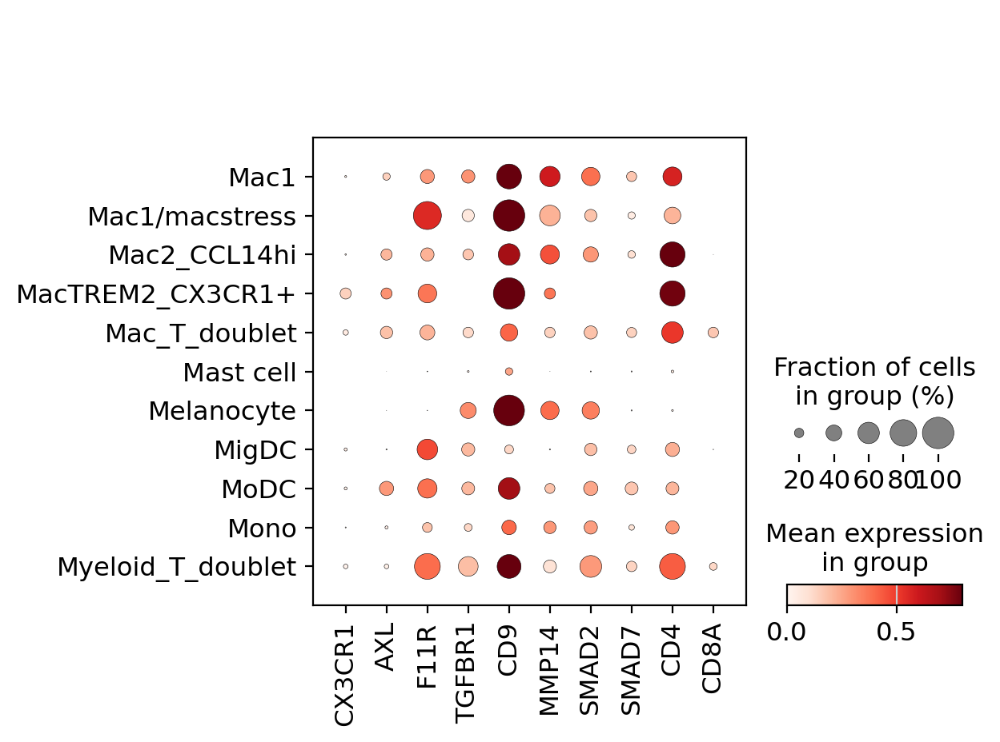

In [30]:



sc.pl.dotplot(adata_i, 
              ['CX3CR1', 'AXL','F11R', 'TGFBR1', 'CD9',
                  'MMP14', 'SMAD2', 'SMAD7' , "CD4", "CD8A"
               ],
              groupby="provisional_celltypes",
              dendrogram=False, 
               # standard_scale="var", 
             # dot_max=0.3,
              vmax=.8
             )


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

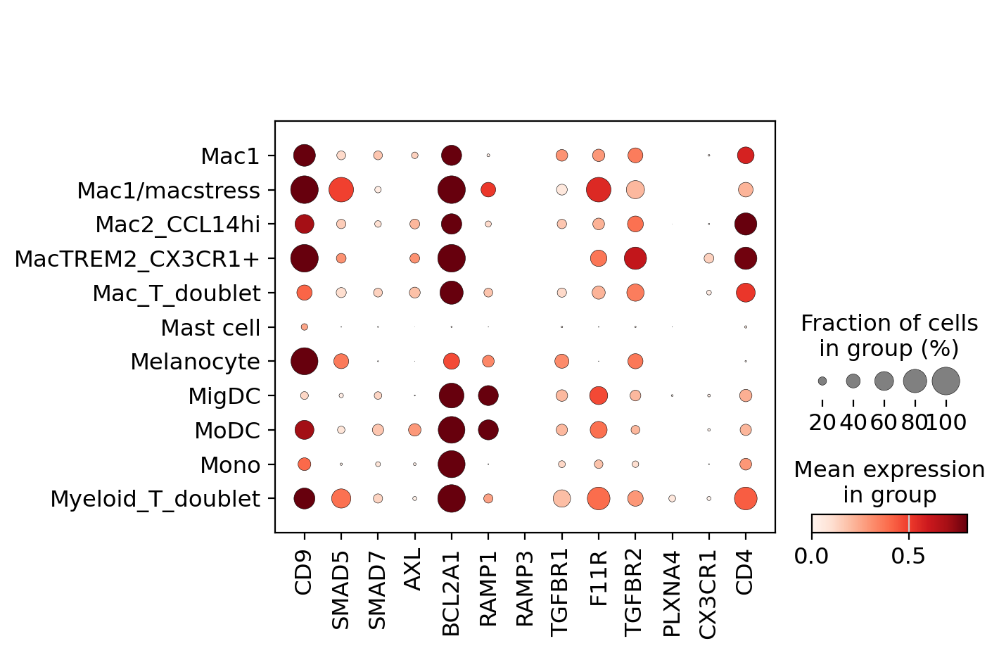

In [27]:


sc.pl.dotplot(adata_i, 
              ["CD9", "SMAD5", "SMAD7",  "AXL", "BCL2A1" , "RAMP1", "RAMP3", "TGFBR1", "F11R","TGFBR2",
               
               #"FCRLS", 
               "PLXNA4",
              "CX3CR1", "CD4"],
              groupby="provisional_celltypes",
              dendrogram=False, 
               # standard_scale="var", 
             # dot_max=0.3,
              vmax=.8
             )


In [5]:
sc.pp.neighbors(adata, n_neighbors=20, use_rep="X_scvi")
print("neighbors calculated")
#RES=1
sc.tl.umap(adata, min_dist=0.1)
print("start leiden")
#sc.tl.leiden(adata_ii, resolution=RES, random_state=1, key_added="test2")

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/umap/dist

neighbors calculated
start leiden


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


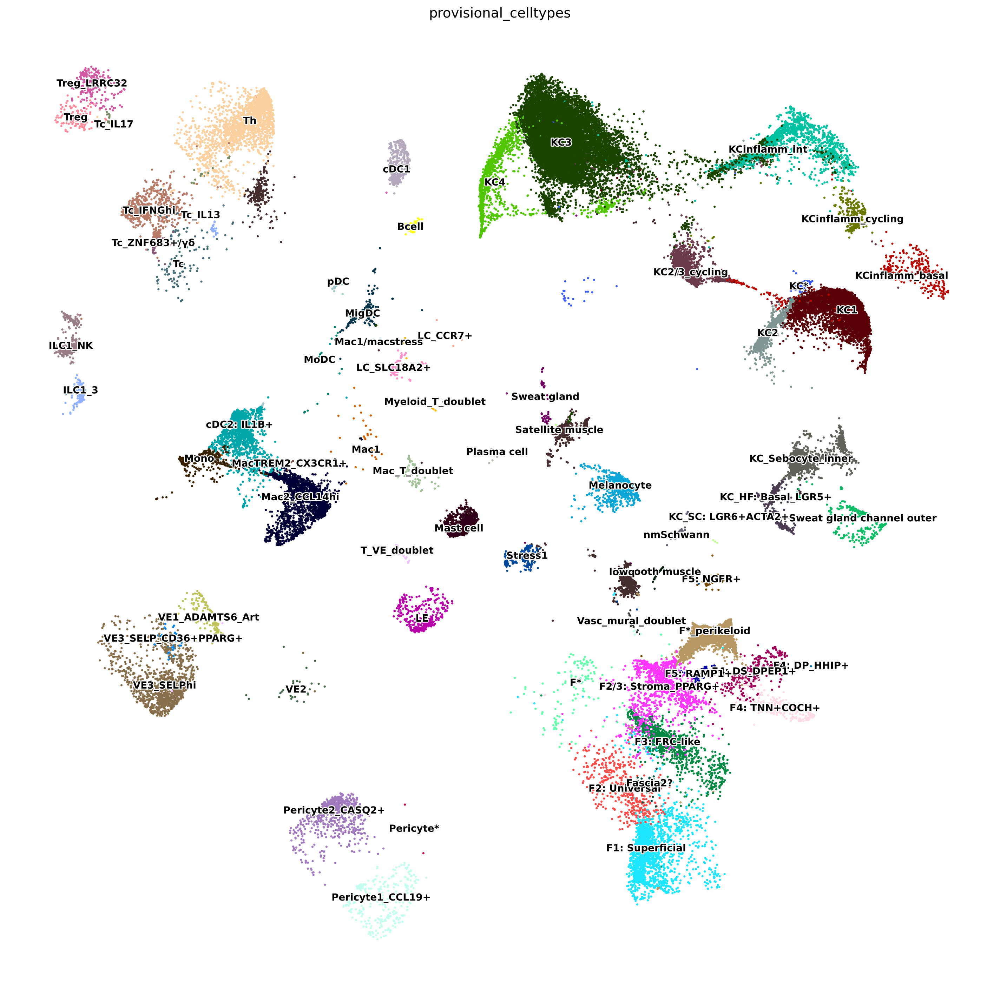

In [5]:
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata,  
       color = [  "provisional_celltypes",#"Mapping_status"
               ],
                
      s=20, vmax=5, vmin=-10,
     legend_loc="on data", 
           legend_fontoutline=2,
      legend_fontsize=10)
# sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
# sc.pl.umap(adata,  
#        color = [ "lvl4_annotation", 
#                ],|
                
#       s=2, vmax=5, vmin=-10,
#       legend_loc="on data", legend_fontoutline=2,
#       legend_fontsize=10)

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


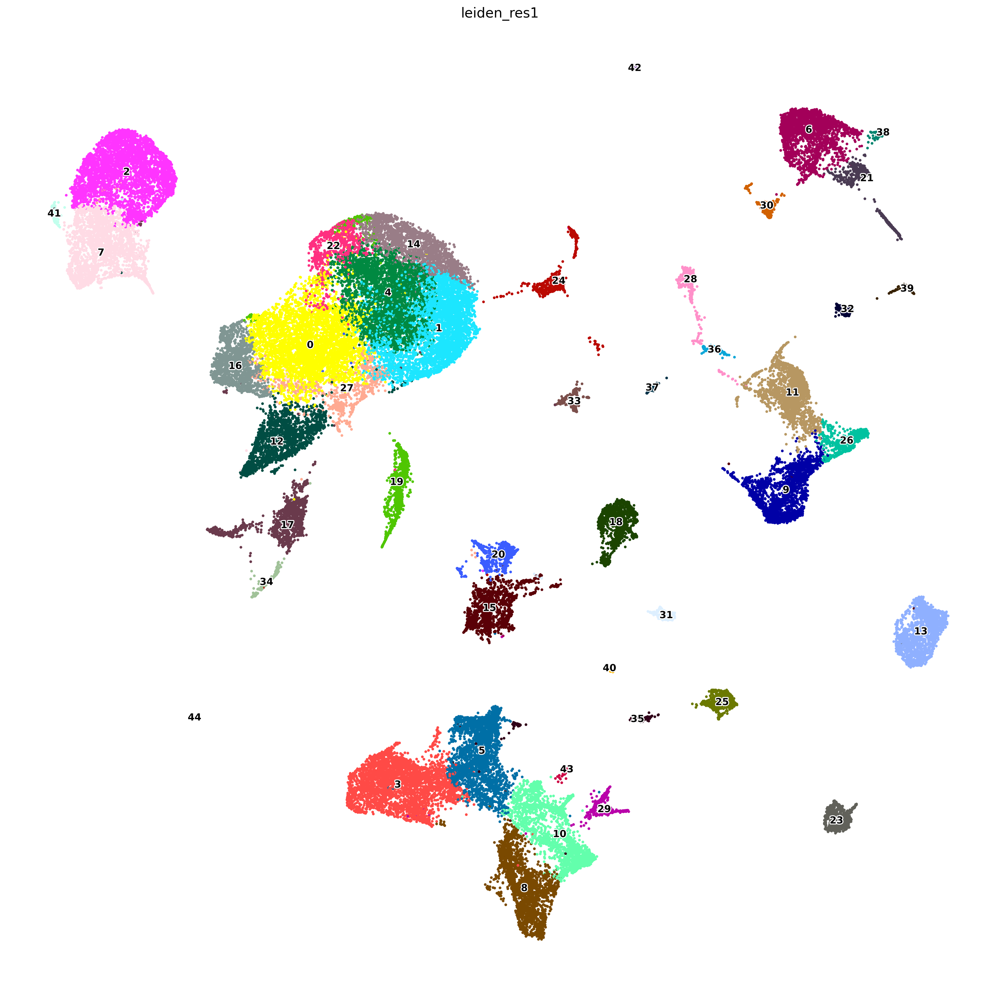

In [7]:
#subset_cluster = ["10"]
RES=1
sc.tl.leiden(adata, #restrict_to=('leiden_res0.2',subset_cluster), 
             resolution=RES, random_state=1, key_added=f'leiden_res{RES}')# neighbors_key=f'neighbor_{neighbor}')

sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata,  
       color = f'leiden_res{RES}',
                
      s=30, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=10)


In [9]:
adata_i=adata[adata.obs[f'leiden_res{RES}'].isin(["3", "5", "10", "8", "29", "43"])]

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


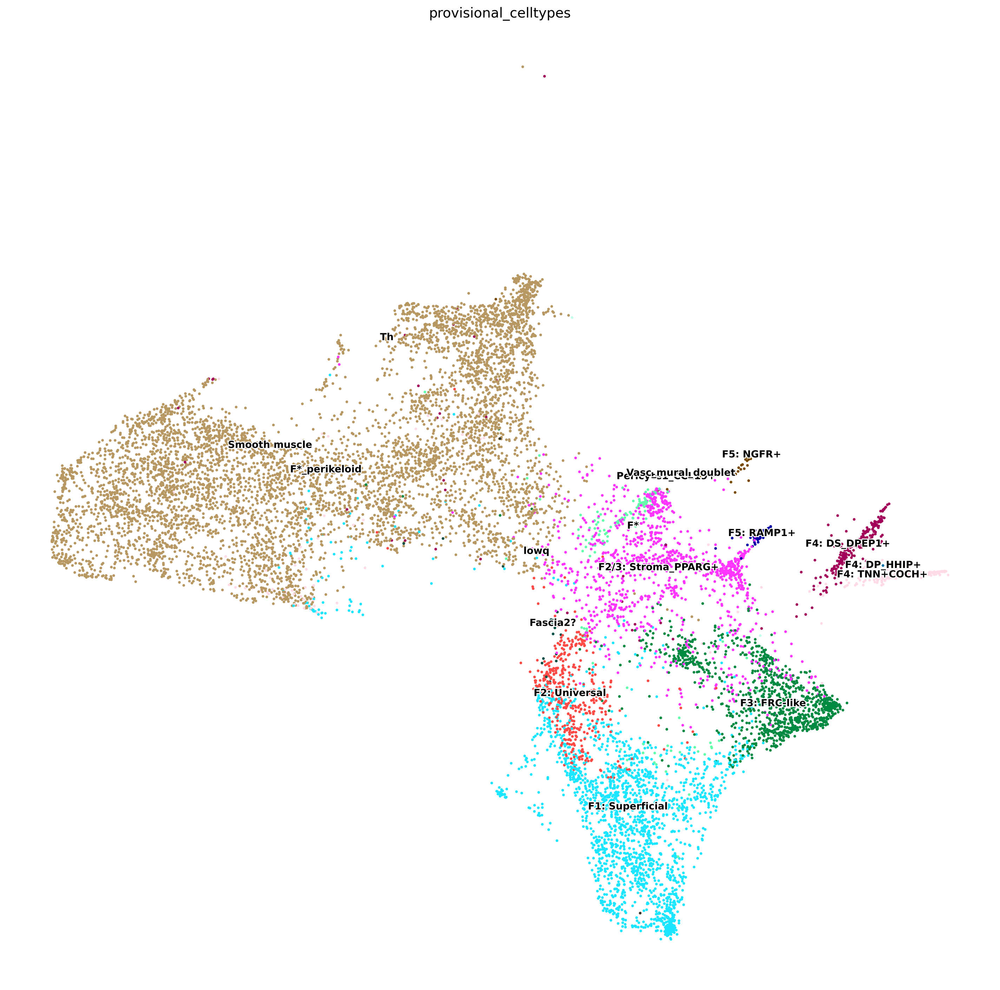

In [10]:
sc.pl.umap(adata_i,  
       color = "provisional_celltypes",
                
      s=30, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=10)


In [11]:
sc.pp.neighbors(adata_i, n_neighbors=20, use_rep="X_scvi")
print("neighbors calculated")
#RES=1
sc.tl.umap(adata_i, min_dist=0.1)
print("start leiden")
#sc.tl.leiden(adata_ii, resolution=RES, random_state=1, key_added="test2")

neighbors calculated
start leiden


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


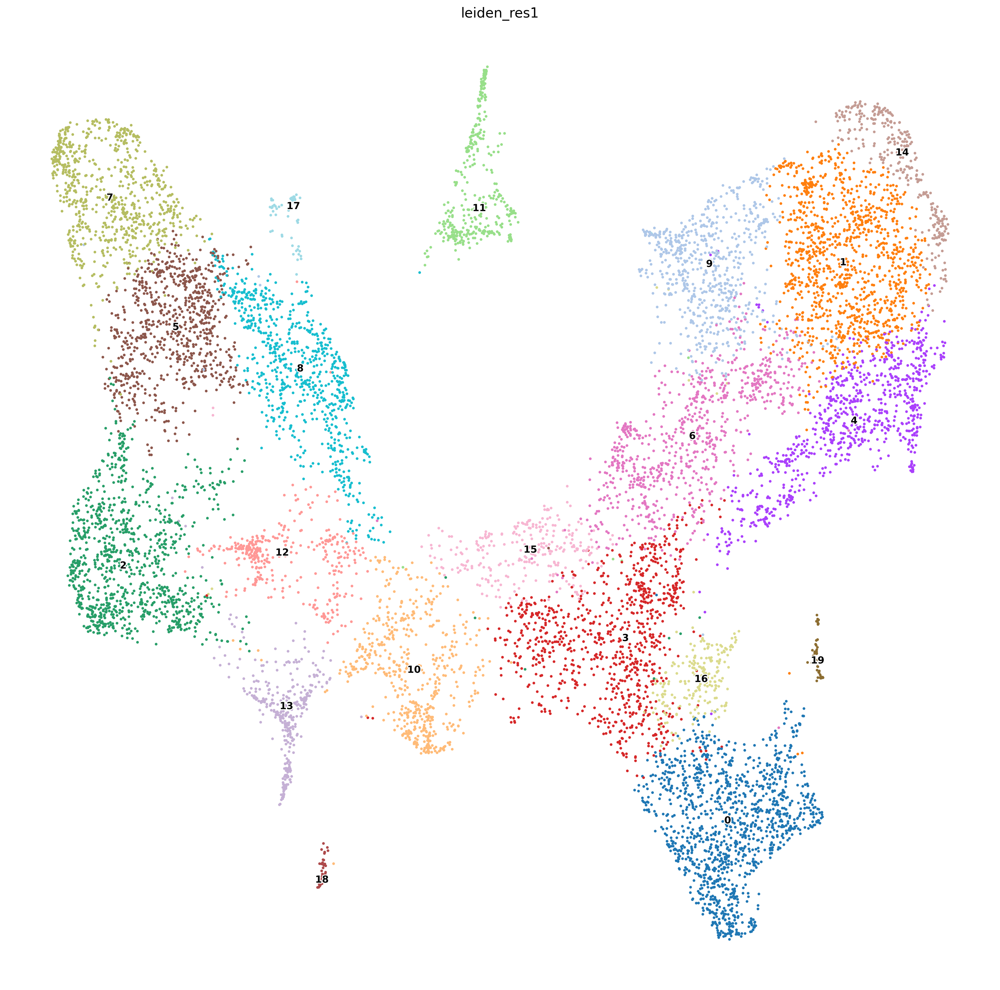

In [12]:

#subset_cluster = ["10"]
RES=1
sc.tl.leiden(adata_i, #restrict_to=('leiden_res0.2',subset_cluster), 
             resolution=RES, random_state=1, key_added=f'leiden_res{RES}')# neighbors_key=f'neighbor_{neighbor}')

sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata_i,  
       color = f'leiden_res{RES}',
                
      s=30, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=10)


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


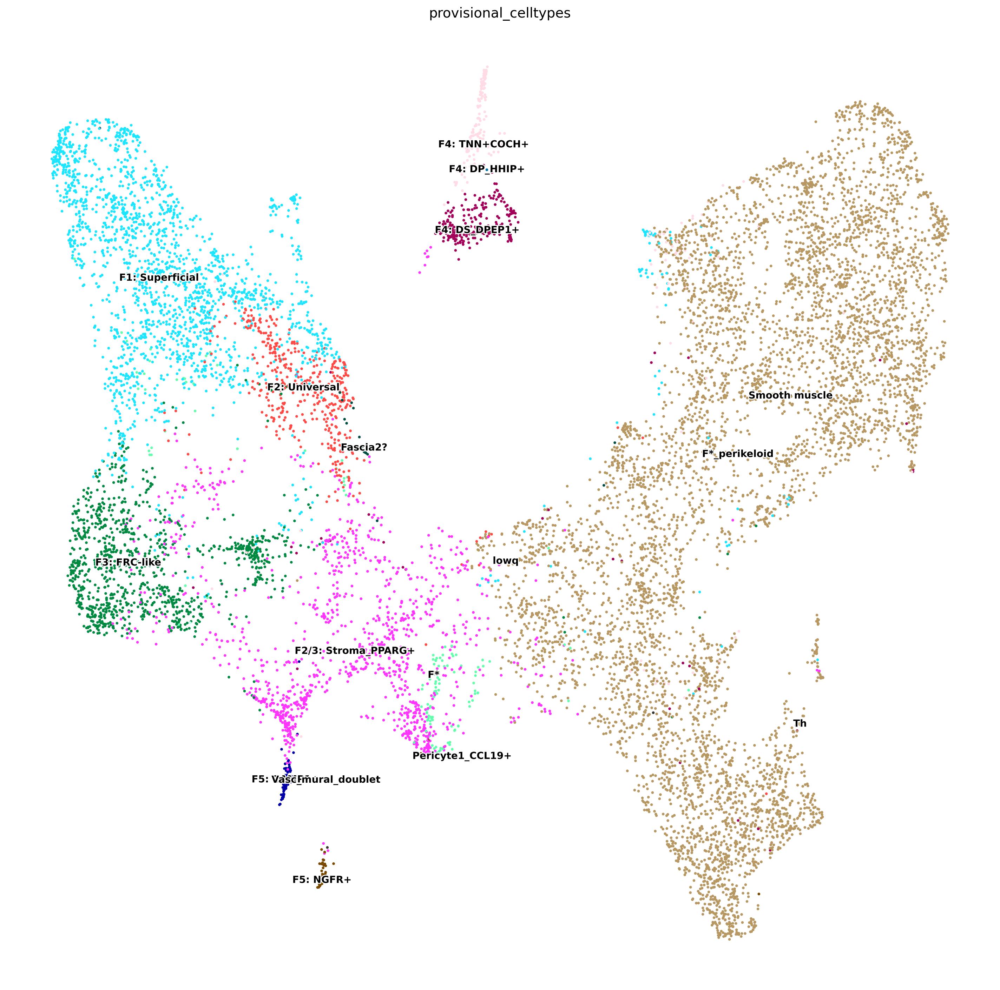

In [13]:
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata_i,  
       color = f'provisional_celltypes',
                
      s=30, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=10)


In [22]:
import pickle

# Define the path to your pickle file
pickle_file_path = '/nfs/team298/ls34/fb_dict.pkl'

# Open the pickle file and load the dictionary
with open(pickle_file_path, 'rb') as file:
    reynolds_short_final = pickle.load(file)

    import pickle

# Define the path to your pickle file
pickle_file_path = '/nfs/team298/ls34/fb_dict_lesional.pkl'

# Open the pickle file and load the dictionary
with open(pickle_file_path, 'rb') as file:
    LESIONAL = pickle.load(file)


In [20]:
FBS = {'F1': ['APCDD1',
  'COL18A1',
  'COL23A1',
  'COL13A1',
  'COMP',
  'NKD2',
  'RSPO1',
  'AXIN2',
  'WIF1',
  'SFRP2'],
                    "Activated F1": [ 'CRABP1',
  'TNFRSF21',
  'CXCL1'],
                   'F1+F6:My_Inf': ['WNT5A', 'COL7A1'],
 'F2: Universal': ['CD34',
  'PI16',
  'DPP4',
  'MFAP5',
  'PCOLCE2',
  'CTHRC1',
  'SLPI',
  'CD70',
  'LGR5'],
 'F2/3: Bridge': ['CXCL12',
  'APOE',
  'EFEMP1',
  'APOC1',
  'C7',
  'PLA2G2A',
  'PPARG',
  'MYOC',
  'GDF10'],
       
 'F3': ['CCL19',
  'CD74',
  'CH25H',
  'TNFSF13B',
  'IL33',
  'IRF8',
  'IL15',
  'VCAM1',
  'HLA-DRA',
  'HLA-DRB1'],
          "Activated F3": ["ADAMDEC1", "CXCL9", "CXCL10"],
 'F4': ['ASPN'],
 'F4: DS_DPEP1+': ['COL11A1', 'MEF2C', 'DPEP1', 'MYL4'],
 'F4: TNN+COCH+': ['TNN',
  'COCH',
  'CRABP1',
  'COL24A1',
  'RSPO4',
  'SLITRK6',
  'NRG3',
  'MKX',
  'TNMD'],
 'F4: DP_HHIP+': ['CORIN',
  'BMP7',
  'WNT5A',
  'LEF1',
  'HHIP',
  'RSPO3',
  'INHBA',
  'PTCH1'],
 'F5': ['SCN7A', 'FMO2', 'FGFBP2', 'OLFML2A'],
 'F5+: RAMP1': ['RAMP1', 'RELN', 'PLEKHA6', 'IGFBP2', 'SFRP1'],
 'F5: NGFR+': ['EBF2', 'NGFR', 'SFRP4', 'ITGA6', 'CDH19', 'CLDN1'],
'F6: Myofibroblast inflammatory': ['CXCL8',
  'CXCL5',
  'CXCL6',
  'CXCL13',
  'IL11',
  'IL24',
  'MMP1',
  'MMP3',
  'IL7R',
  'INHBA',
  'CSF3',
  'TDO2',
  'WWC1',
  'CHI3L1',
  'STAT4',
  'CCL5',
  'CCL3',
  'CCL11'],
 'F6 (both)': ['WNT2', 'COL10A1', 'LAMP5'],
         
         }



/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

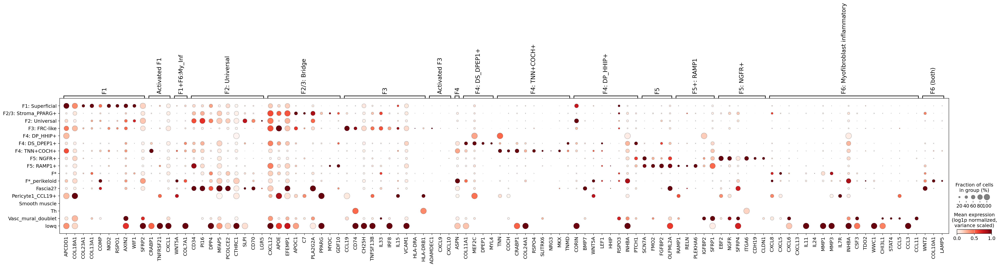

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

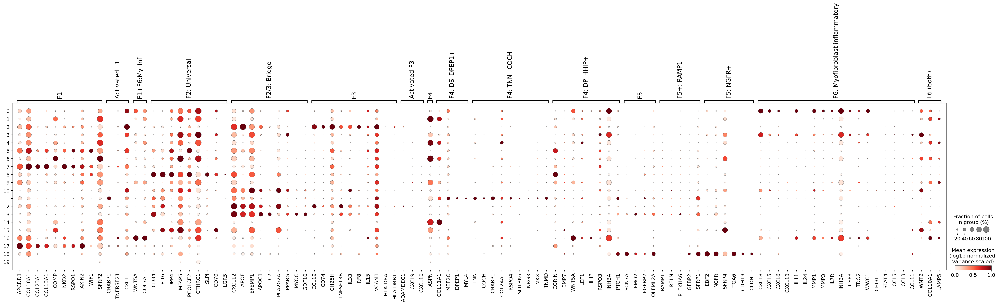

In [21]:
sc.pl.dotplot(
    adata_i,
    FBS,
    groupby="provisional_celltypes",
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 


sc.pl.dotplot(
    adata_i,
    FBS,
    groupby=f'leiden_res{RES}',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 
 
 

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


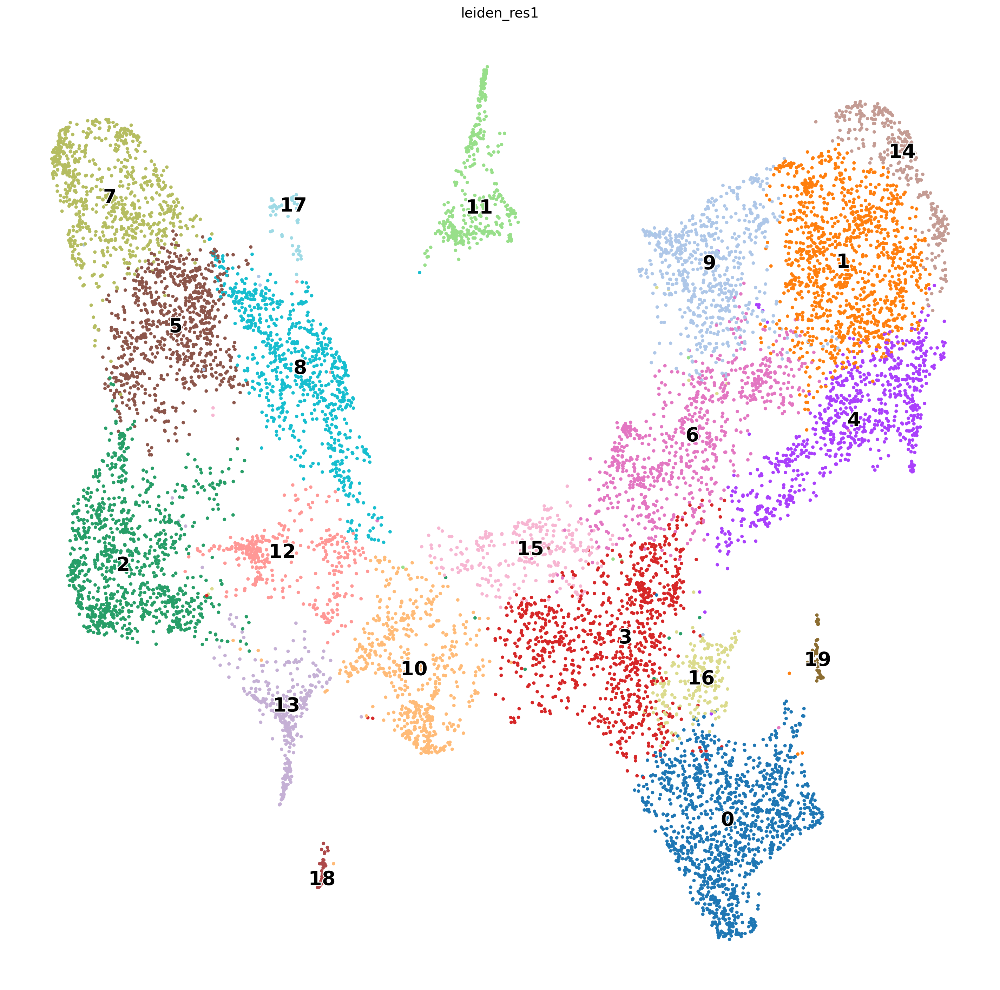

In [28]:
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata_i,  
       color = f'leiden_res{RES}',
                
      s=50, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=20)


In [29]:
# ### NORMALISE
# # adata.layers["counts"]=adata.X.copy()
sc.pp.normalize_total(adata_i, target_sum=1e4)
sc.pp.log1p(adata_i)


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

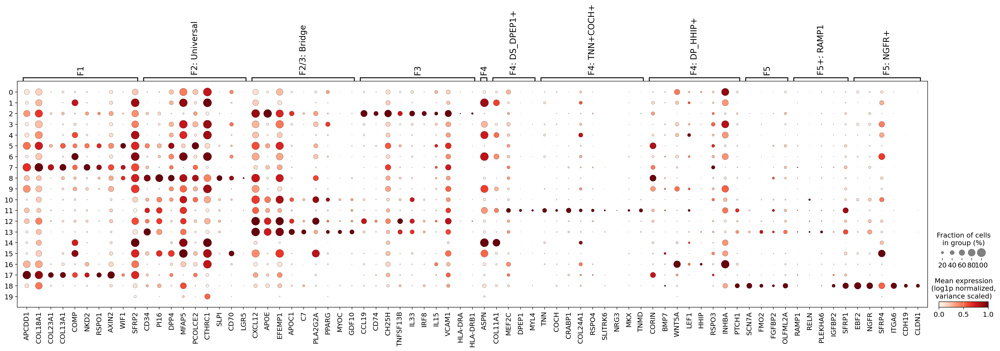

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

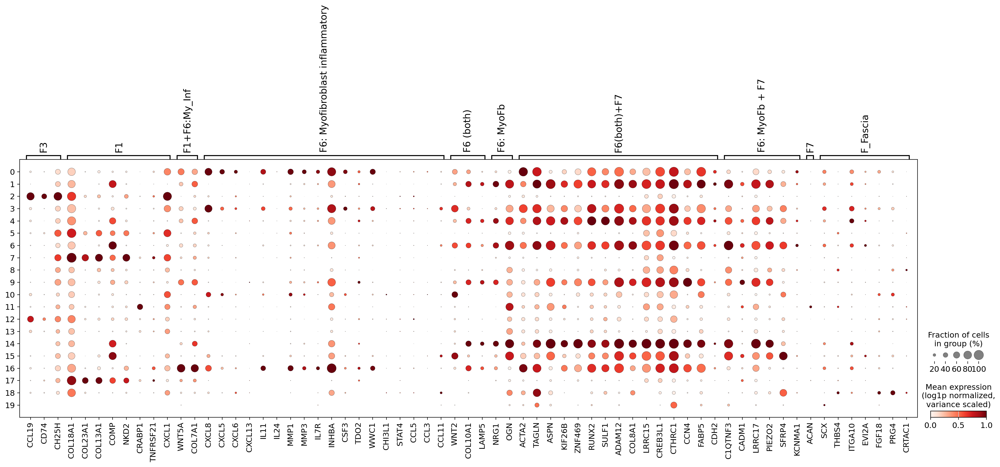

In [30]:
sc.pl.dotplot(
    adata_i,
    reynolds_short_final,
    groupby=f'leiden_res{RES}',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 


sc.pl.dotplot(
    adata_i,
    LESIONAL,
    groupby=f'leiden_res{RES}',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 
 
 


In [31]:
RENAME = {'4':  'F6: Myofibroblast',
 '0': 'F6: Inflammatory myofibroblast',
 '16':  'F6: Inflammatory myofibroblast',
 '6':  'F6: Myofibroblast',
 '9':  'F6: Myofibroblast',
 '1': 'F6: Myofibroblast',
 '12': 'F3: FRC-like',
 '5': 'F1: Superficial',
 '15':  'F6: Myofibroblast',
 '8': 'F2: Universal',
 '3':  'F6: Inflammatory myofibroblast',
 '10': 'F2/3: Stroma_PPARG+',
 '11': 'F4',
 '17': 'F1: Superficial',
 '2': 'F3: FRC-like',
 '13':'F2/3: Stroma_PPARG+',
 '7': 'F1: Superficial',
 '14': 'F6: Myofibroblast',
 '18': 'F5',
 '19': 'lowq'}
adata_i.obs[f'annotation']=adata_i.obs[f'leiden_res{RES}'].map(RENAME)

In [32]:
{x:x for x in adata_i.obs[f'leiden_res{RES}'].unique()}

{'4': '4',
 '0': '0',
 '16': '16',
 '6': '6',
 '9': '9',
 '1': '1',
 '12': '12',
 '5': '5',
 '15': '15',
 '8': '8',
 '3': '3',
 '10': '10',
 '11': '11',
 '17': '17',
 '2': '2',
 '13': '13',
 '7': '7',
 '14': '14',
 '18': '18',
 '19': '19'}

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


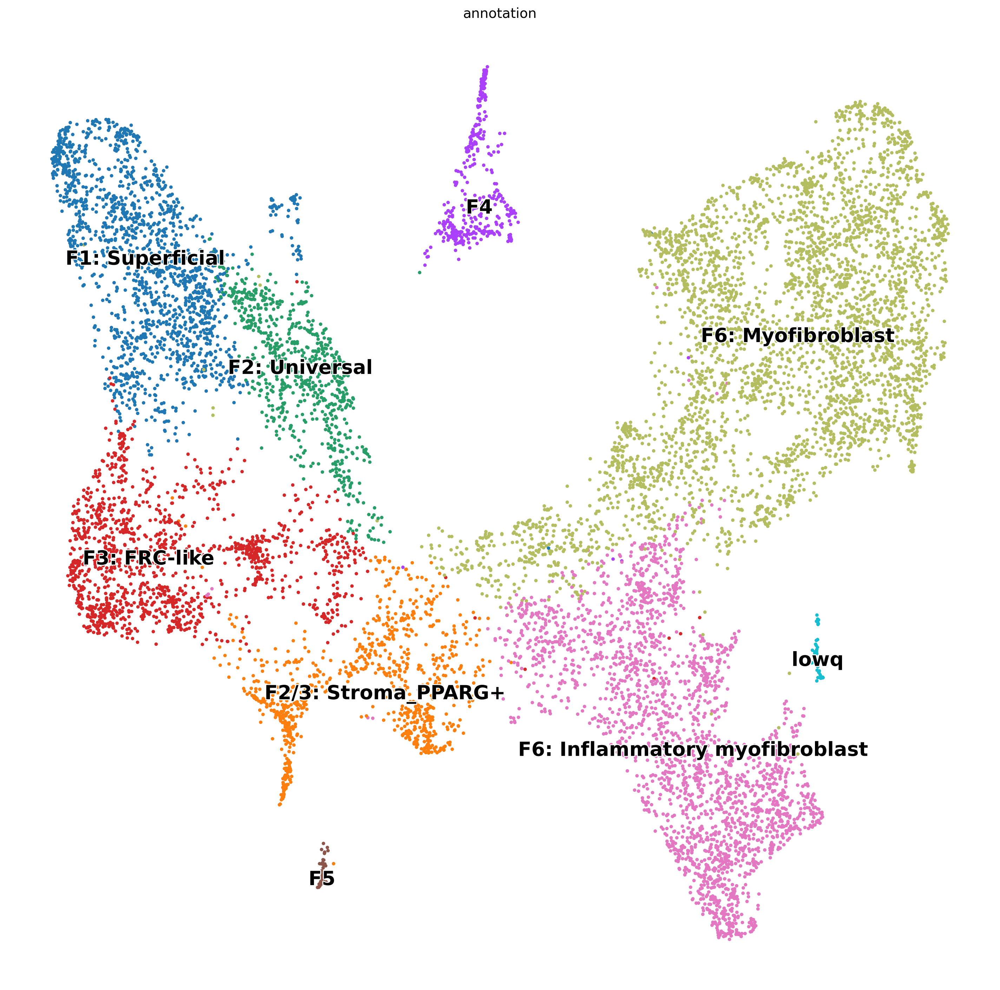

In [33]:
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata_i,  
       color = f'annotation',
                
      s=50, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=20)


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

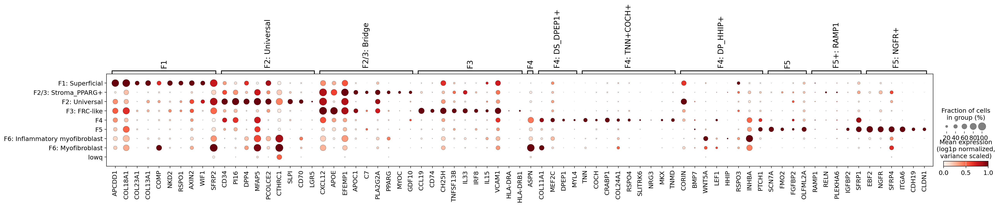

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

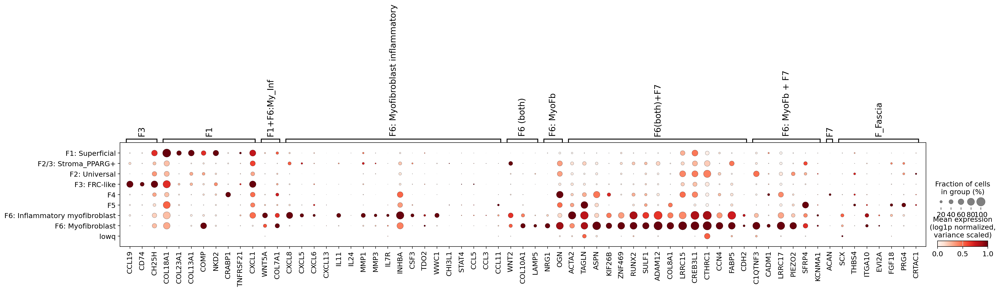

In [35]:
sc.pl.dotplot(
    adata_i,
    reynolds_short_final,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 


sc.pl.dotplot(
    adata_i,
    LESIONAL,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 
 
 


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


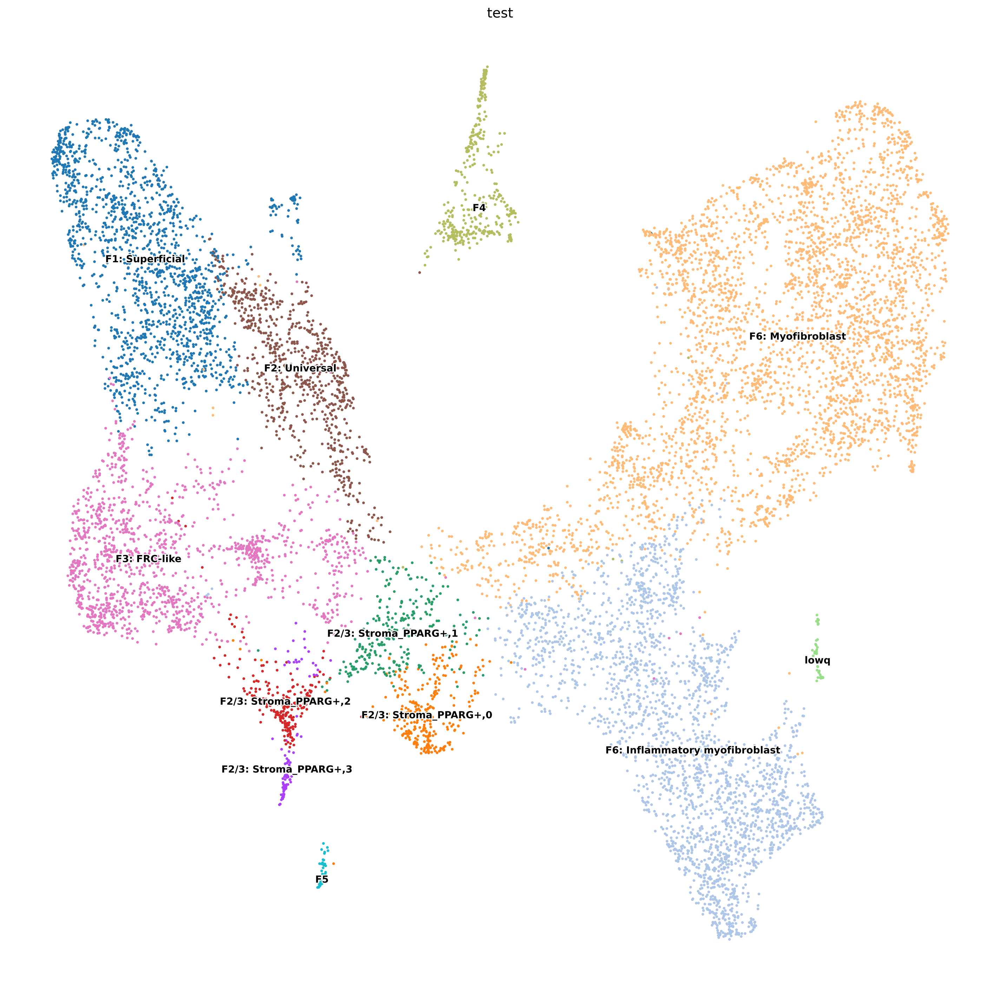

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

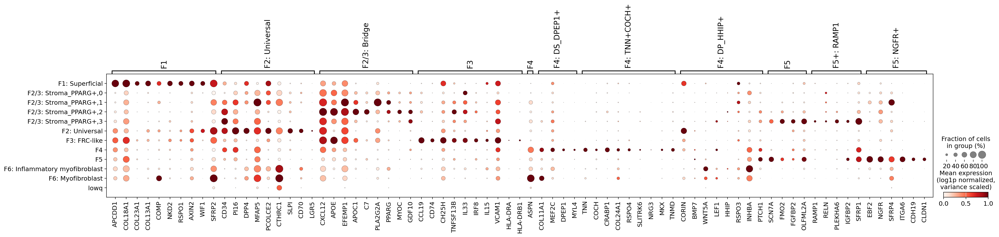

In [41]:
subset_cluster = ["F2/3: Stroma_PPARG+"]
RES=0.3
sc.tl.leiden(adata_i, restrict_to=('annotation',subset_cluster), 
             resolution=RES, random_state=1, key_added='test')# neighbors_key=f'neighbor_{neighbor}')

sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata_i,  
       color = f'test',
                
      s=30, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=10)
sc.pl.dotplot(
    adata_i,
    reynolds_short_final,
    groupby=f'test',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


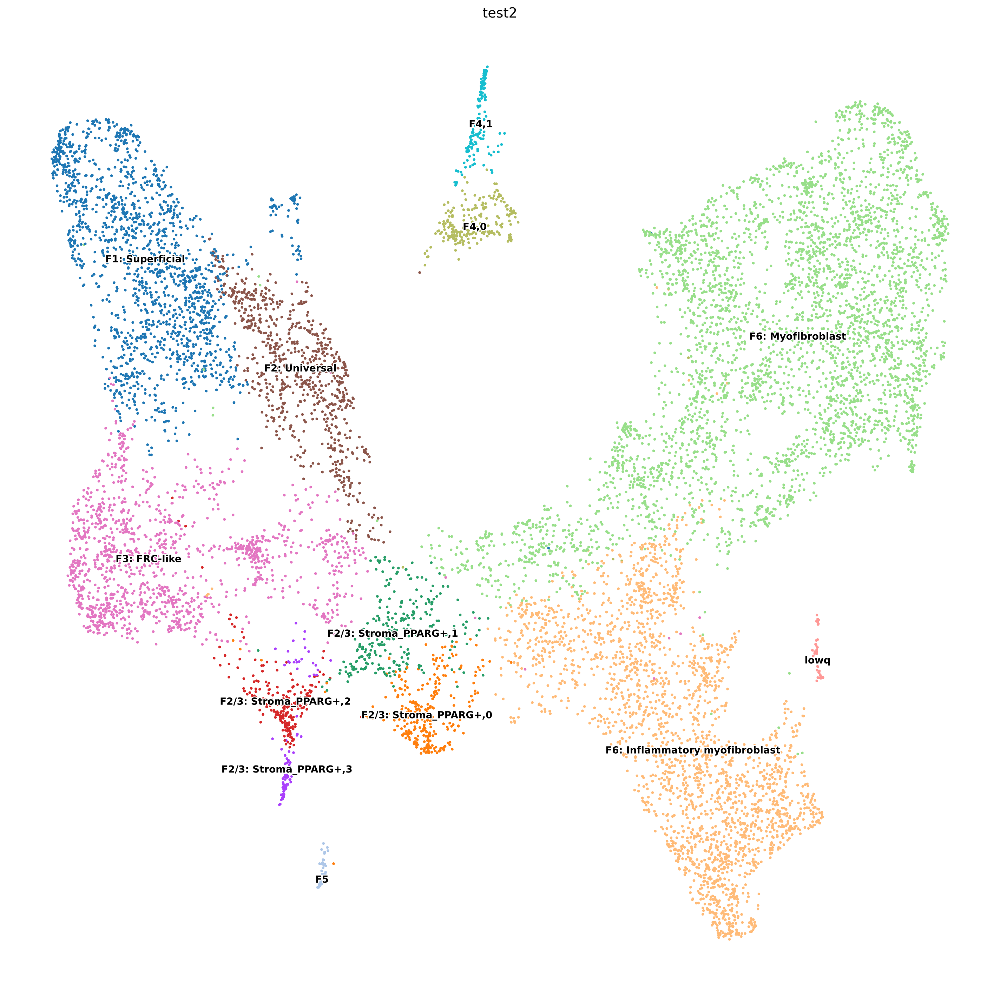

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

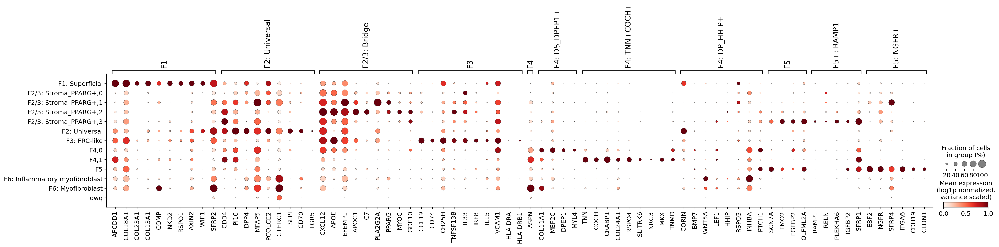

In [46]:
subset_cluster = ["F4"]
RES=0.1
sc.tl.leiden(adata_i, restrict_to=('test',subset_cluster), 
             resolution=RES, random_state=1, key_added='test2')# neighbors_key=f'neighbor_{neighbor}')

sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata_i,  
       color = f'test2',
                
      s=30, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=10)
sc.pl.dotplot(
    adata_i,
    reynolds_short_final,
    groupby=f'test2',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 


In [48]:
{x:x for x in adata_i.obs["test2"].unique()}

{'F6: Myofibroblast': 'F6: Myofibroblast',
 'F6: Inflammatory myofibroblast': 'F6: Inflammatory myofibroblast',
 'F3: FRC-like': 'F3: FRC-like',
 'F1: Superficial': 'F1: Superficial',
 'F2: Universal': 'F2: Universal',
 'F2/3: Stroma_PPARG+,1': 'F2/3: Stroma_PPARG+,1',
 'F4,0': 'F4,0',
 'F4,1': 'F4,1',
 'F2/3: Stroma_PPARG+,2': 'F2/3: Stroma_PPARG+,2',
 'F2/3: Stroma_PPARG+,0': 'F2/3: Stroma_PPARG+,0',
 'F2/3: Stroma_PPARG+,3': 'F2/3: Stroma_PPARG+,3',
 'F5': 'F5',
 'lowq': 'lowq'}

In [55]:
RENAME = {'F6: Myofibroblast': 'F6: Myofibroblast',
 'F6: Inflammatory myofibroblast': 'F6: Inflammatory myofibroblast',
 'F3: FRC-like': 'F3: FRC-like',
 'F1: Superficial': 'F1: Superficial',
 'F2: Universal': 'F2: Universal',
 'F2/3: Stroma_PPARG+,1': 'F2/3: Stroma_PPARG+',
 'F4,0': 'F4: DS_DPEP1+',
 'F4,1': 'F4: TNN+COCH+',
 'F2/3: Stroma_PPARG+,2': 'F2/3: Stroma_PPARG+',
 'F2/3: Stroma_PPARG+,0': 'F2/3: Stroma_PPARG+',
 'F2/3: Stroma_PPARG+,3': 'F5: RAMP1+',
 'F5': 'F5: NGFR+',
 'lowq': 'lowq'}

adata_i.obs["annotation"] = adata_i.obs["test2"].map(RENAME)

In [58]:
adata_i = adata_i[adata_i.obs["annotation"] !="lowq"]

In [61]:
import pandas as pd
desired_order =  [ 'F1: Superficial',# 'F1: Regenerative',
                  'F2: Universal',
 'F2/3: Stroma_PPARG+',
                  'F3: FRC-like',


 'F4: DS_DPEP1+',
 'F4: TNN+COCH+',
 #'F4: DP_HHIP+',
                  'F5: RAMP1+', 'F5: NGFR+', 'F6: Inflammatory myofibroblast',
 'F6: Myofibroblast',
# 'F_Fascia',
                 #'lowq'
                 ]
CATEGORY="annotation"

# Ensure 'lvl3_annotation' is categorical
if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
    adata_i.obs[CATEGORY] = adata_i.obs[CATEGORY].astype('category')

if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
    adata_i.obs[CATEGORY] = adata_i.obs[CATEGORY].astype('category')

if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
    adata_i.obs[CATEGORY] = adata_i.obs[CATEGORY].astype('category')

missing_data = 0
for x in list(adata_i.obs[CATEGORY].unique()):
    if x not in desired_order:
        print(x)
        missing_data +=1
if missing_data != 0:
    stop
        
        
# Set the categories in the desired order
adata_i.obs[CATEGORY] = pd.Categorical(
    adata_i.obs[CATEGORY],
    categories=desired_order,
    ordered=True
)
 

/tmp/ipykernel_12643/1439714687.py:19: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
/tmp/ipykernel_12643/1439714687.py:22: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
/tmp/ipykernel_12643/1439714687.py:25: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
/tmp/ipykernel_12643/1439714687.py:38: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_i.obs[CATEGORY] = pd.Categorical(


In [100]:
reynolds_short_final

{'F1': ['APCDD1',
  'COL18A1',
  'COL23A1',
  'COL13A1',
  'COMP',
  'NKD2',
  'RSPO1',
  'AXIN2',
  'WIF1',
  'SFRP2'],
 'F2: Universal': ['CD34',
  'PI16',
  'DPP4',
  'MFAP5',
  'PCOLCE2',
  'CTHRC1',
  'SLPI',
  'CD70',
  'LGR5'],
 'F2/3: Bridge': ['CXCL12',
  'APOE',
  'EFEMP1',
  'APOC1',
  'C7',
  'PLA2G2A',
  'PPARG',
  'MYOC',
  'GDF10'],
 'F3': ['CCL19',
  'CD74',
  'CH25H',
  'TNFSF13B',
  'IL33',
  'IRF8',
  'IL15',
  'VCAM1',
  'HLA-DRA',
  'HLA-DRB1'],
 'F4': ['ASPN'],
 'F4: DS_DPEP1+': ['COL11A1', 'MEF2C', 'DPEP1', 'MYL4'],
 'F4: TNN+COCH+': ['TNN',
  'COCH',
  'CRABP1',
  'COL24A1',
  'RSPO4',
  'SLITRK6',
  'NRG3',
  'MKX',
  'TNMD'],
 'F4: DP_HHIP+': ['CORIN',
  'BMP7',
  'WNT5A',
  'LEF1',
  'HHIP',
  'RSPO3',
  'INHBA',
  'PTCH1'],
 'F5': ['SCN7A', 'FMO2', 'FGFBP2', 'OLFML2A'],
 'F5+: RAMP1': ['RAMP1', 'RELN', 'PLEKHA6', 'IGFBP2', 'SFRP1'],
 'F5: NGFR+': ['EBF2', 'NGFR', 'SFRP4', 'ITGA6', 'CDH19', 'CLDN1']}

In [111]:
ALL_GENES={'F1': ['APCDD1',
  'COL18A1',
  'COL23A1',
  'COL13A1',
  'COMP',
  'NKD2',
  'RSPO1',
  'AXIN2',
  'WIF1',
  'SFRP2'],
 'F2: Universal': ['CD34',
  'PI16',
  'DPP4',
  'MFAP5',
  'PCOLCE2',
  'CTHRC1',
  'SLPI',
  'CD70',
  'LGR5'],
 'F2/3: Bridge': ['CXCL12',
  'APOE',
  'EFEMP1',
  'APOC1',
  'C7',
  'PLA2G2A',
  'PPARG',
  'MYOC',
  'GDF10'],
 'F3': ['CCL19',
  'CD74',
  'CH25H',
  'TNFSF13B',
  'IL33',
  'IRF8',
  'IL15',
  'VCAM1',
  'HLA-DRA',
  'HLA-DRB1'],
 'F4': ['ASPN'],
 'F4: DS_DPEP1+': ['COL11A1', 'MEF2C', 'DPEP1', 'MYL4'],
 'F4: TNN+COCH+': ['TNN',
  'COCH',
  'CRABP1',
  'COL24A1',
  'RSPO4',
  'SLITRK6',
  'NRG3',
  'MKX',
  'TNMD'],
 'F5': ['SCN7A', 'FMO2', 'FGFBP2', 'OLFML2A'],
 'F5+: RAMP1': ['RAMP1', 'RELN', 'PLEKHA6', 'IGFBP2', 'SFRP1'],
 'F5: NGFR+': ['EBF2', 'NGFR', 'SFRP4', 'ITGA6', 'CDH19', 'CLDN1'],
          'F1+F6:My_Inf': ['WNT5A', 'COL7A1'],
            'F6 (both)': ['WNT2', 'COL10A1', 'LAMP5'],
 'F6: Myofibroblast inflammatory': ['CXCL8',
  'CXCL5',
  'CXCL6',
  'CXCL13',
  'IL11',
  'IL24',
  'MMP1',
  'MMP3',
  'IL7R',
  'INHBA',
  'CSF3',
  'TDO2',
  'WWC1',
  'CHI3L1',
  'STAT4',
  'CCL5',
  'CCL3',
  'CCL11', "FAM167A"],
 'F6: MyoFb': ['NRG1', 'OGN', 'ACTA2',
  'TAGLN',
  'ASPN',
  'KIF26B',
  'ZNF469',
  'RUNX2',
  'SULF1',
  'ADAM12',
  'COL8A1',
  'LRRC15',
  'CREB3L1',
  'CTHRC1',
  'CCN4',
  'FABP5',
  'CDH2', 'C1QTNF3', 'CADM1', 'LRRC17', 'PIEZO2', 'SFRP4', 'KCNMA1'],
          
          
          }

In [101]:
LESIONAL

{'F3': ['CCL19', 'CD74', 'CH25H'],
 'F1': ['COL18A1',
  'COL23A1',
  'COL13A1',
  'COMP',
  'NKD2',
  'CRABP1',
  'TNFRSF21',
  'CXCL1'],
 'F1+F6:My_Inf': ['WNT5A', 'COL7A1'],
 'F6: Myofibroblast inflammatory': ['CXCL8',
  'CXCL5',
  'CXCL6',
  'CXCL13',
  'IL11',
  'IL24',
  'MMP1',
  'MMP3',
  'IL7R',
  'INHBA',
  'CSF3',
  'TDO2',
  'WWC1',
  'CHI3L1',
  'STAT4',
  'CCL5',
  'CCL3',
  'CCL11'],
 'F6 (both)': ['WNT2', 'COL10A1', 'LAMP5'],
 'F6: MyoFb': ['NRG1', 'OGN'],
 'F6(both)+F7': ['ACTA2',
  'TAGLN',
  'ASPN',
  'KIF26B',
  'ZNF469',
  'RUNX2',
  'SULF1',
  'ADAM12',
  'COL8A1',
  'LRRC15',
  'CREB3L1',
  'CTHRC1',
  'CCN4',
  'FABP5',
  'CDH2'],
 'F6: MyoFb + F7': ['C1QTNF3', 'CADM1', 'LRRC17', 'PIEZO2', 'SFRP4', 'KCNMA1'],
 'F7': ['ACAN'],
 'F_Fascia': ['SCX', 'THBS4', 'ITGA10', 'EVI2A', 'FGF18', 'PRG4', 'CRTAC1']}

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


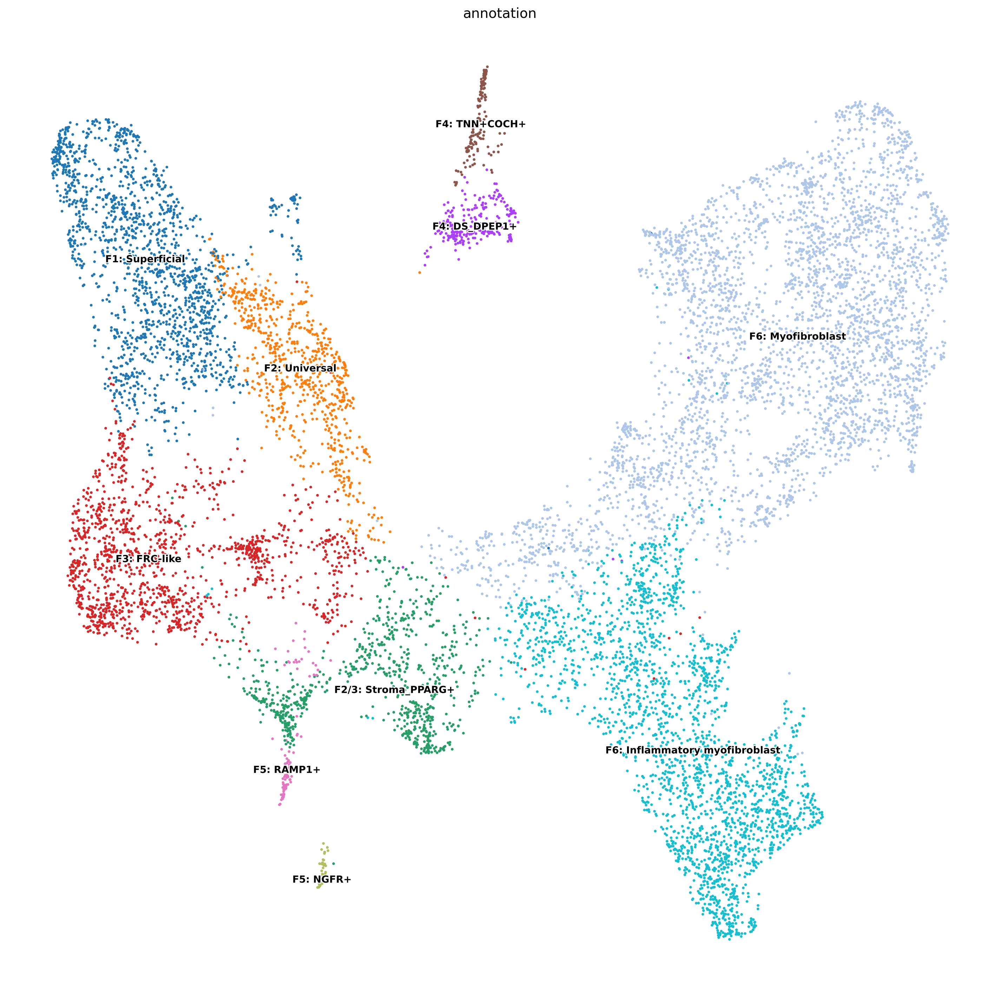

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

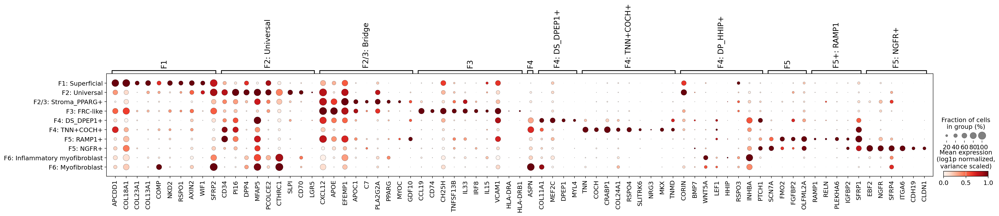

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

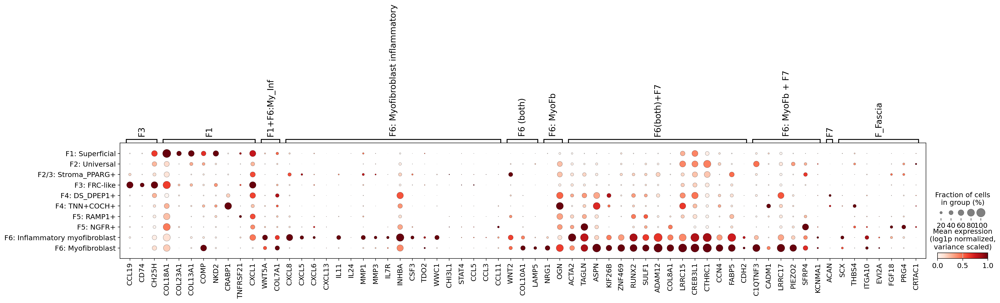

In [62]:
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata_i,  
       color = f'annotation',
                
      s=30, vmax=2, vmin=0,
      legend_loc="on data", legend_fontoutline=2,
      legend_fontsize=10)
sc.pl.dotplot(
    adata_i,
    reynolds_short_final,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 
sc.pl.dotplot(
    adata_i,
    LESIONAL,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 

In [112]:
sc.pl.dotplot(
    adata_i,
    ALL_GENES,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

In [ ]:
desired_order =  [ 'F1: Superficial', 'F1: Regenerative', 'F2: Universal',
 'F2/3: Stroma_PPARG+','F3: FRC-like',






 'F4: DS_DPEP1+',
 'F4: TNN+COCH+',
 'F4: DP_HHIP+', 'F5: RAMP1+', 'F5: NGFR+', 'F6: Inflammatory myofibroblast',

 'F_Fascia',
                 'lowq']

# Ensure 'lvl3_annotation' is categorical
if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
    adata_i.obs[CATEGORY] = adata_i.obs[CATEGORY].astype('category')

if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
    adata_i.obs[CATEGORY] = adata_i.obs[CATEGORY].astype('category')

if not pd.api.types.is_categorical_dtype(adata_i.obs[CATEGORY]):
    adata_i.obs[CATEGORY] = adata_i.obs[CATEGORY].astype('category')

missing_data = 0
for x in list(adata_i.obs[CATEGORY].unique()):
    if x not in desired_order:
        print(x)
        missing_data +=1
if missing_data != 0:
    stop
        
        
# Set the categories in the desired order
adata_i.obs[CATEGORY] = pd.Categorical(
    adata_i.obs[CATEGORY],
    categories=desired_order,
    ordered=True
)
 

In [64]:
adata_i.obs.sample_id.value_counts()

sample_id
PWH27D30    2151
PWH27D7     2011
PWH28D30    1584
PWH26D7      927
PWH28D0      907
PWH28D7      889
PWH26D30     865
PWH26D0      736
PWH27D0      532
PWH27D1      501
PWH28D1      263
PWH26D1      257
Name: count, dtype: int64

In [65]:
TIME =  {
    "PWH26D1": "Day1",
    "PWH26D7": "Day7",
    "PWH27D1": "Day1",
    "PWH27D7": "Day7",
    "PWH28D1": "Day1",
    "PWH28D7": "Day7",
    "PWH26D0": "Baseline",
    "PWH26D30": "Day30",
    "PWH27D0": "Baseline",
    "PWH27D30": "Day30",
    "PWH28D0": "Day30",
    "PWH28D30": "Day30"
}
adata_i.obs["Time"]=adata_i.obs["sample_id"].map(TIME)


/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

<Axes: xlabel='UMAP1', ylabel='UMAP2'>

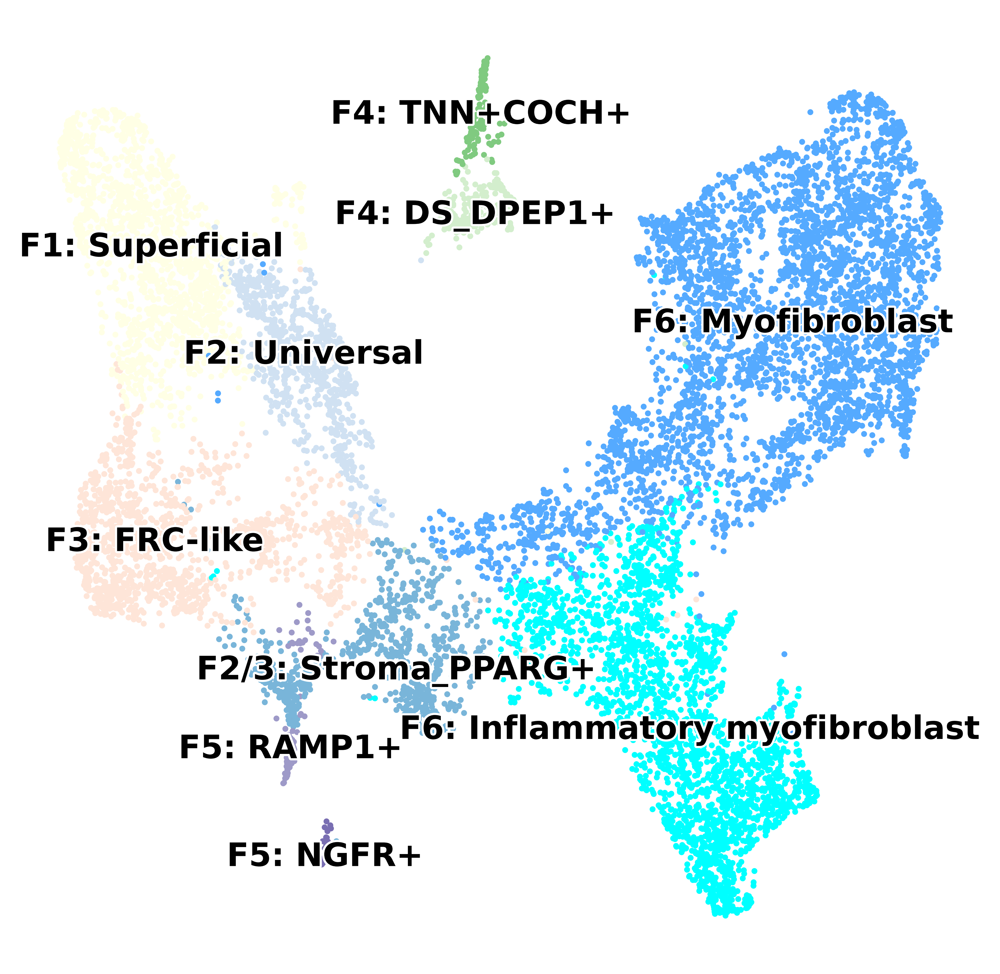

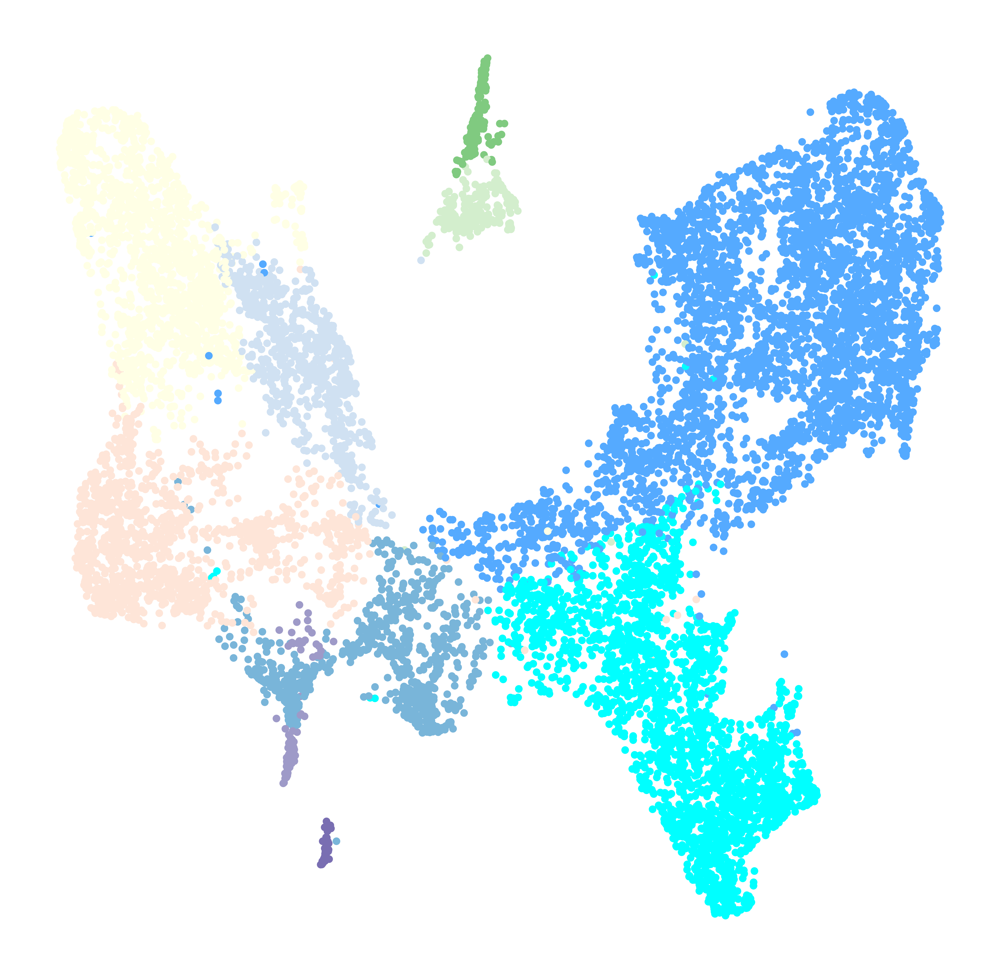

In [99]:
custom_colors = {"F1: Superficial": np.array([1.        , 1.        , 0.89803922, 1.        ]),
 'F1: Regenerative': np.array([0.99607843, 0.80915033, 0.39607843, 1.        ]),
 'F2: Universal': np.array([0.81411765, 0.88392157, 0.94980392, 1.        ]),
 "F2/3: Stroma_PPARG+": np.array([0.47294118, 0.71163399, 0.85071895, 1.        ]),
 'F3: FRC-like': np.array([0.99692426, 0.89619377, 0.84890427, 1.        ]),
 'F4: DS_DPEP1+': np.array([0.82745098, 0.93254902, 0.80313725, 1.        ]),
 'F4: TNN+COCH+': np.array([0.50196078, 0.79058824, 0.50143791, 1.        ]),
 'F4: DP_HHIP+': np.array([0.15294118, 0.56183007, 0.28313725, 1.        ]),
 'F5: RAMP1+':np.array([0.6177624 , 0.60213764, 0.78345252, 1.        ]),
 'F5: NGFR+': np.array([0.47320261, 0.43267974, 0.69934641, 1.        ]),
 'F6: Inflammatory myofibroblast': np.array([0., 1., 1., 1.]),
 'F6: Myofibroblast': np.array([0.33333333, 0.66666667, 1.        , 1.        ]),
       'F7: Fascia-like myofibroblast': np.array([0.95686275, 0.55686275, 0.74509804, 1.0]),
 'F_Fascia': np.array([0, 0, 0, 0.3])
                               }


try:
    adata_i.uns["annotation_colors"] = [custom_colors[cat] for cat in adata_i.obs["annotation"].cat.categories]
except KeyError as e:
    print(f"Error: Missing color for category {e}")
sc.settings.set_figure_params(dpi=300, facecolor="white", frameon=False, figsize=(8, 8
                                                                                 ))
# Generate the UMAP plot
sc.pl.umap(
    adata_i,
    color='annotation',
    show=False,
    frameon=False,
    legend_loc="on data",
    legend_fontsize=15,
    s=30,
    title='',
    legend_fontoutline=2
)

sc.pl.umap(
    adata_i,
    color='annotation',
    show=False,
    frameon=False,
    legend_loc=None,
    legend_fontsize=15,
    s=50,
    title='',
    legend_fontoutline=2
)
# sc.pl.umap(
#     adata,
#     color='test13',
#     show=False,
#     frameon=False,
#     #legend_loc="on data",
#     legend_fontsize=2,
#     s=10,
#     title='',
#     legend_fontoutline=2,
#     #save="fig3_renamedpopulations.png"
# )

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


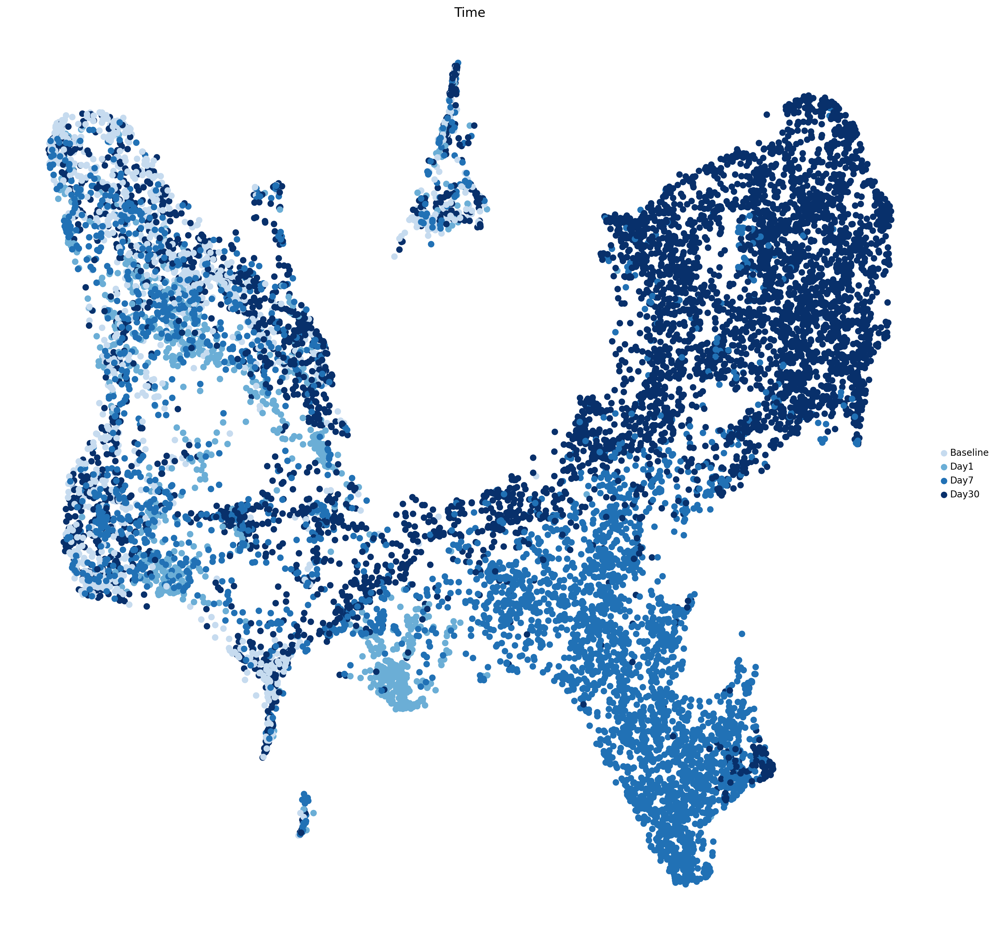

In [83]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import scanpy as sc

# Define custom colors (dark blue to light blue)
# custom_palette = {
#     "Baseline": "#08306b",  # Dark blue
#     "Day1": "#2171b5",      # Medium-dark blue
#     "Day7": "#6baed6",      # Medium-light blue
#     "Day30": "#c6dbef"      # Light blue
# }
custom_palette = {
    "Baseline": "#c6dbef" ,  # Dark blue
    "Day1":   "#6baed6",   # Medium-dark blue
    "Day7":  "#2171b5",      # Medium-light blue
    "Day30":  "#08306b"    # Light blue
}

# Apply colors
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(
    adata_i,
    color="Time",
    s=200,
    palette=custom_palette,  # Apply custom color mapping
    legend_fontoutline=2,
    legend_fontsize=10
)

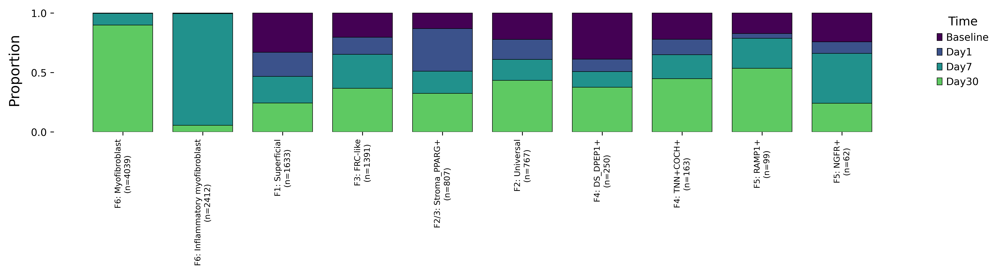

In [72]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Compute value counts for each annotation
category_counts = adata_i.obs['annotation'].value_counts()

# Compute the proportion of each annotation across "Time"
grouped = adata_i.obs.groupby(['annotation', 'Time'], observed=True).size().unstack(fill_value=0)
proportions = grouped.div(grouped.sum(axis=1), axis=0)

# Sorting (optional, can be removed if not needed)
sorted_proportions = proportions.loc[
    category_counts.index  # Sort by total cell counts in annotation
]
# Define colors for each time point
custom_colors = {
    time: plt.cm.viridis(i / len(proportions.columns))  # Using Viridis colormap
    for i, time in enumerate(proportions.columns)
}
color_list = [custom_colors[col] for col in sorted_proportions.columns]

# Plotting
fig, ax = plt.subplots(figsize=(14, 4), dpi=300)

bar_width = 0.75  
indices = np.arange(len(sorted_proportions))

bottom = np.zeros(len(sorted_proportions))
for i, col in enumerate(reversed(sorted_proportions.columns)):
    heights = np.nan_to_num(sorted_proportions[col])

    ax.bar(
        indices,
        heights,
        bar_width,
        bottom=bottom,
        color=color_list[-(i + 1)],
        label=col,
        edgecolor="black" if np.any(heights > 0) else None,  
        linewidth=0.5
    )
    bottom += heights

# X-axis labels
xtick_labels = [
    f"{label}\n(n={category_counts.get(label, 0)})" if label in category_counts else ""
    for label in sorted_proportions.index
]
valid_ticks = [i for i, label in enumerate(xtick_labels) if label != ""]

ax.set_xticks(valid_ticks)
ax.set_xticklabels([xtick_labels[i] for i in valid_ticks], rotation=90, fontsize=8)

# Formatting
ax.set_xlabel('')
ax.set_ylabel('Proportion', fontsize=14, labelpad=10)
plt.yticks(fontsize=10)
plt.ylim(0, 1.05)  # Adjusted to remove extra space

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.grid(False)

# Legend
handles, labels = ax.get_legend_handles_labels()
legend = ax.legend(reversed(handles), reversed(labels), bbox_to_anchor=(1.02, 1), loc='upper left', 
                   frameon=False, fontsize=10, title="Time", title_fontsize=12)
plt.setp(legend.get_texts(), fontsize='10')

plt.tight_layout()
plt.show()

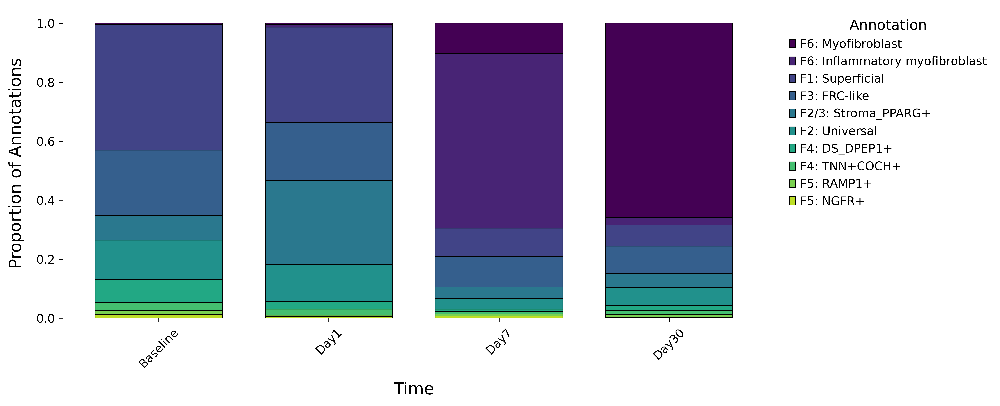

In [73]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Count occurrences of each annotation within each Time
grouped = adata_i.obs.groupby(['Time', 'annotation'], observed=True).size().unstack(fill_value=0)

# Convert to proportions per Time (each bar sums to 1)
proportions = grouped.div(grouped.sum(axis=1), axis=0)

# Sort annotations by total counts across all times (optional)
annotation_counts = adata_i.obs["annotation"].value_counts()
sorted_annotations = annotation_counts.index

# Reorder proportions dataframe by sorted annotations
proportions = proportions[sorted_annotations.intersection(proportions.columns)]

# Define colors for each annotation
custom_colors = {
    annotation: plt.cm.viridis(i / len(proportions.columns))  
    for i, annotation in enumerate(proportions.columns)
}
color_list = [custom_colors[col] for col in proportions.columns]

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12, 5), dpi=300)

bar_width = 0.75  
indices = np.arange(len(proportions))

bottom = np.zeros(len(proportions))
for i, annotation in enumerate(reversed(proportions.columns)):  
    heights = np.nan_to_num(proportions[annotation])

    ax.bar(
        indices,
        heights,
        bar_width,
        bottom=bottom,
        color=color_list[-(i + 1)],
        label=annotation,
        edgecolor="black" if np.any(heights > 0) else None,
        linewidth=0.5
    )
    bottom += heights

# X-axis labels (Time points)
ax.set_xticks(indices)
ax.set_xticklabels(proportions.index, rotation=45, fontsize=10)

# Formatting
ax.set_xlabel('Time', fontsize=14, labelpad=10)
ax.set_ylabel('Proportion of Annotations', fontsize=14, labelpad=10)
plt.yticks(fontsize=10)
plt.ylim(0, 1.05)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.grid(False)

# Legend
handles, labels = ax.get_legend_handles_labels()
legend = ax.legend(reversed(handles), reversed(labels), bbox_to_anchor=(1.02, 1), loc='upper left', 
                   frameon=False, fontsize=10, title="Annotation", title_fontsize=12)
plt.setp(legend.get_texts(), fontsize='10')

plt.tight_layout()
plt.show()

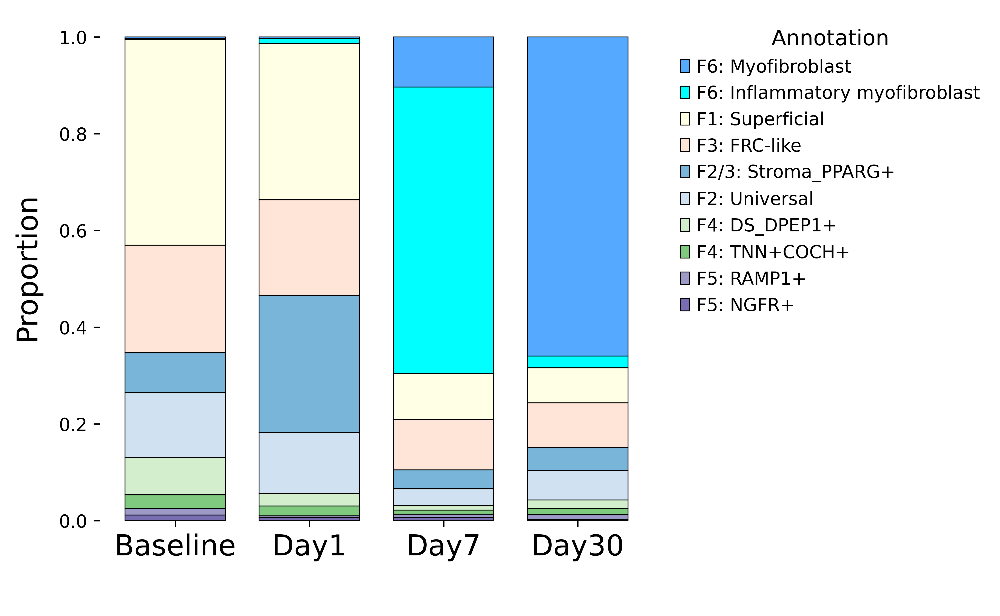

In [92]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Group by Time and compute proportions of each annotation
grouped = adata_i.obs.groupby(['Time', 'annotation'], observed=True).size().unstack(fill_value=0)
proportions = grouped.div(grouped.sum(axis=1), axis=0)

# Sort annotations by total frequency (optional)
annotation_counts = adata_i.obs["annotation"].value_counts()
sorted_annotations = annotation_counts.index
proportions = proportions[sorted_annotations.intersection(proportions.columns)]

# Apply custom colors (fallback to grey if annotation not in custom_colors)
color_list = [custom_colors.get(ann, np.array([0.8, 0.8, 0.8, 1.0])) for ann in proportions.columns]

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(8, 5), dpi=300)

bar_width = 0.75  
indices = np.arange(len(proportions))

bottom = np.zeros(len(proportions))
for i, annotation in enumerate(reversed(proportions.columns)):  
    heights = np.nan_to_num(proportions[annotation])

    ax.bar(
        indices,
        heights,
        bar_width,
        bottom=bottom,
        color=color_list[-(i + 1)],  # Use custom RGBA color
        label=annotation,
        edgecolor="black" if np.any(heights > 0) else None,
        linewidth=0.5
    )
    bottom += heights

# X-axis formatting
ax.set_xticks(indices)
ax.set_xticklabels(proportions.index, rotation=0, fontsize=16)

ax.set_xlabel(' ', fontsize=14, labelpad=10)
ax.set_ylabel('Proportion', fontsize=16, labelpad=10)
plt.yticks(fontsize=10)
plt.ylim(0, 1.05)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.grid(False)

# Legend
handles, labels = ax.get_legend_handles_labels()
legend = ax.legend(reversed(handles), reversed(labels), bbox_to_anchor=(1.02, 1), loc='upper left', 
                   frameon=False, fontsize=10, title="Annotation", title_fontsize=12)
plt.setp(legend.get_texts(), fontsize='10')

plt.tight_layout()
plt.show()

In [79]:
adata_i.write('/nfs/team298/ls34/new_disease_atlas/model_scanvi5_Wound_5846/adata_mappedonly_notatlas.h5ad.counts.annotated2')



In [1]:
adata_i

NameError: name 'adata_i' is not defined

In [1]:
2

2

In [1]:
import scanpy as sc
adata_i=sc.read_h5ad('/nfs/team298/ls34/new_disease_atlas/model_scanvi5_Wound_5846/adata_mappedonly_notatlas.h5ad.counts.annotated2')



/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

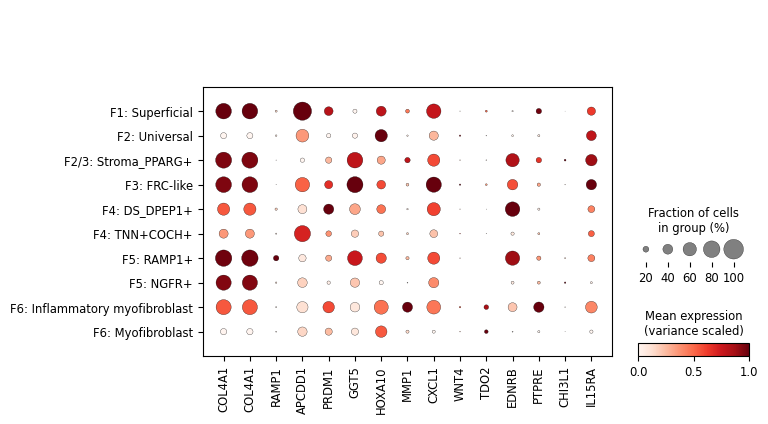

In [2]:
F6 = ["COL4A1", "COL4A1", "RAMP1", "APCDD1", "PRDM1", "GGT5", "HOXA10", "MMP1", "CXCL1", "WNT4", "TDO2", "EDNRB", "PTPRE", "CHI3L1", "IL15RA"]
sc.pl.dotplot(
    adata_i,
    F6,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(variance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

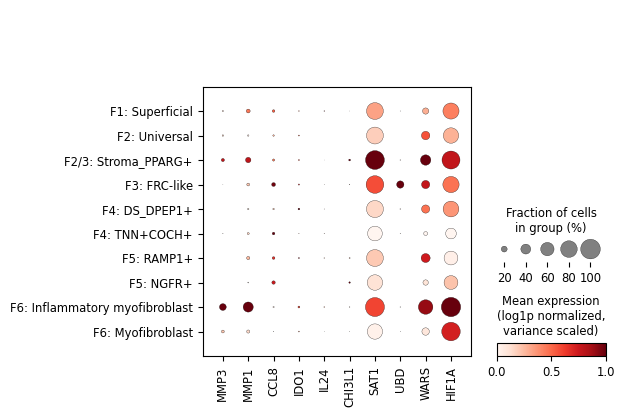

In [3]:
icaf = ['MMP3', 'MMP1',
        'CCL8', 'IDO1', 'IL24', 'CHI3L1', 'SAT1', 'UBD', 
        'WARS', "HIF1A"]

sc.pl.dotplot(
    adata_i,
    icaf,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(variance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

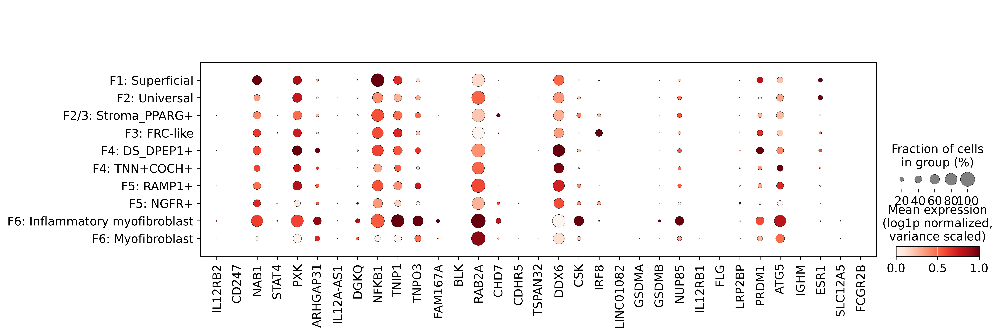

In [110]:
scc_gwas = [
    "IL12RB2", "CD247", #"LOC100506023",
     "NAB1", "STAT4", "PXK", "ARHGAP31", 
    "IL12A-AS1", "DGKQ", "NFKB1", "TNIP1", "TNPO3", "FAM167A", "BLK", 
    "RAB2A", "CHD7", "CDHR5", "TSPAN32", "DDX6", "CSK", 
    "IRF8", "LINC01082", "GSDMA", "GSDMB", "NUP85", "IL12RB1", "FLG", "LRP2BP", 
    "PRDM1", "ATG5", "IGHM", "ESR1", "SLC12A5", "FCGR2B"
]

sc.pl.dotplot(
    adata_i,
    scc_gwas,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(log1p normalized,\nvariance scaled)', 
   standard_scale="var",
    dendrogram=False,
) 

In [7]:
ALL_GENES={'F1': ['APCDD1',
  'COL18A1',
  'COL23A1',
  'COL13A1',
  'NKD2',
  'RSPO1',
  'AXIN2',
  'WIF1',
  #'SFRP2'
                 ],
 'F2: Universal': ['CD34',
  'PI16',
  'DPP4',
  'MFAP5',
  'PCOLCE2',
  #'CTHRC1',
  'SLPI',
  'CD70',
  'LGR5'],
 'F2/3: Bridge': ['CXCL12',
  'APOE',
  'EFEMP1',
  'APOC1',
  'C7',
  'PLA2G2A',
  'PPARG',
  'MYOC',
  'GDF10'],
 'F3': ['CCL19',
  'CD74',
  'CH25H',
  'TNFSF13B',
  'IL33',
  'IRF8',
  'IL15',
  'VCAM1',
  'HLA-DRA',
  'HLA-DRB1'],
 'F4: DS_DPEP1+': [ 'MEF2C', 'DPEP1', 'MYL4'],
 'F4: TNN+COCH+': ['TNN',
  'COCH',
  'CRABP1',
  'COL24A1',
  'RSPO4',
  'SLITRK6',
  'NRG3',
  'MKX',
  'TNMD'],
 'F5': ['SCN7A', 'FMO2', 'FGFBP2', 'OLFML2A'],
 'F5+: RAMP1': ['RAMP1', 'RELN', 'PLEKHA6', 'IGFBP2', 'SFRP1'],
 'F5: NGFR+': ['EBF2', 'NGFR', 'ITGA6', 'CDH19', 'CLDN1'],
          'F1+F6:My_Inf': ['WNT5A', 'COL7A1'],
            'F6 (both)': ['WNT2', 'COL10A1', 'LAMP5'],
 'F6: Myofibroblast inflammatory': ['CXCL8',
  'CXCL5',
  'CXCL6',
  'CXCL13',
  'IL11',
  'IL24',
  'MMP1',
  'MMP3',
  'IL7R',
  'INHBA',
  'CSF3',
  'TDO2',
  'WWC1',
  'CHI3L1',
  'STAT4',
  'CCL5',
  'CCL3',
  'CCL11', "FAM167A"],

 'F6: MyoFb': ['NRG1', 'OGN', 'ACTA2',
  'TAGLN',
  'KIF26B',
  'ZNF469',
  'RUNX2',
  'SULF1',
  'ADAM12',
  'COL8A1',
  'LRRC15',
  'CREB3L1',

 # 'WISP1',
  'FABP5',
  'CDH2', 'C1QTNF3', 'CADM1', 'LRRC17', 'PIEZO2', 'KCNMA1'],
                       'F1/2/4/5 MARKERS  + F6': ['ASPN',   'COMP', 'COL11A1', 'SFRP4',  'CTHRC1', ],

 #           'F7': ['ACAN'],
# 'F_Fascia': ['SCX', 'THBS4', 'ITGA10', 'EVI2A', 'FGF18', 'PRG4', 'CRTAC1']
          
          
          }
sc.settings.set_figure_params(dpi=300, facecolor="white", frameon=False, figsize=(3,3))

sc.pl.dotplot(
    adata_i,
    ALL_GENES,
    groupby=f'annotation',
    #vmax=1.1,
    colorbar_title='Mean expression\n(variance scaled)', 
   standard_scale="var",
    dendrogram=False,
)

/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/jovyan/my-conda-envs/sko_ls/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(